<a href="https://colab.research.google.com/github/HenryZumaeta/MDS_UNI/blob/Zeta/CICLO02/MLNS/TrabajoFinal_MLNS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

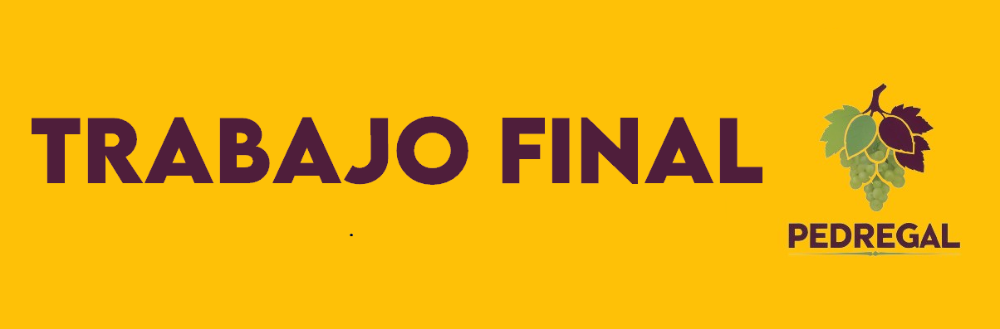

---
**AUTOR:** Henry Paolo Zumaeta Lozano

**MAESTRÍA:** Data Science

**CURSO:** Machine Learning No Supervisado

---

**RESUMEN:**

Segmentación de operarios de raleo de uva.

---

**RECOLECCIÓN DE LA INFORMACIÓN:**

1.   Matriz de operarios de raleo:

    - Parte diario
    - ERM-personal(declarado)
    - Nómina


2.   RCC - Reporte de deudas
    - Superintendencia de Banca y Seguros

3. RENIEC

---

**OBJETIVOS:**

Desarrollar la codificación en Python para llevar a cabo la segmentación de los operarios de la empresa mencionada. Se pueden emplear uno o más algoritmos de segmentación, así como realizar las comparaciones respectivas entre ellos. Además, se solicita describir detalladamente los segmentos resultantes.

---

**MATERIALES DE TRABAJO:**

Para el desarrollo del trabajo se tiene:

raleo_base_clus_clusteres.csv: Es la base de datos a trabajar

Diccionario.pdf: Contiene el diccionario de las variables

---

**NOTA:**

El código está desarrollado en su mayoría en Python, pero también incluye R en la parte de EDA.

---

**RESUMEN DE ALGORITMOS Y PROCESOS UTILIZADOS PARA DEFINIR CLÚSTERES**

**1. Instalación y Configuración de Paquetes**
- **Propósito:** Proporcionar herramientas para exploración, análisis y tratamiento de datos.

**2. Carga y Preparación de Datos**
- **Carga de datos:** Datos descargados desde Google Drive y leídos en un DataFrame de pandas.
- **EDA inicial:** Visualización de la estructura de datos y valores nulos utilizando `skimpy`, `sweetviz`, y `missingno`.

**3. Tratamiento de Datos**
- **Eliminación de columnas no representativas:** Excluidas columnas irrelevantes para el análisis.
- **Manejo de valores nulos:**
  - Imputación de datos faltantes utilizando métodos como la media truncada, mediana y el algoritmo `MissForest`.

**4. Análisis de Correlación y Reducción de Dimensionalidad**
- **Matriz de correlación:** Identificación de columnas altamente correlacionadas y su eliminación.
- **PCA (Análisis de Componentes Principales):**
  - Normalización de datos y reducción de dimensionalidad para mantener el 80% de la varianza.

**5. Imputación y Manejo de Outliers**
- **Detección de outliers:** Uso de diagramas de caja.
- **Imputación de outliers:** Métodos como la media truncada, mediana y algoritmos específicos para reducir el impacto de los outliers.

**6. Preparación de Datos Categóricos**
- **Reemplazo de valores:** Normalización de valores categóricos.
- **Imputación de datos faltantes:** Uso de la moda y `RandomForestClassifier` para datos categóricos.

**7. Clustering y Modelos de Machine Learning**

- **Modelos de clustering utilizados:**

1.    DBSCAN
1.   KMeans
1.   MiniBatchKMeans
1.   Agglomerative Clustering
1.   Birch
1.   MeanShift
1.   Spectral Clustering
1.   Clustering Jerárquico
1.   Autoencoder + KMeans

**8. Evaluación de Modelos**
- **Métricas utilizadas:**
1.   **Silhouette Score**
1.   **Davies-Bouldin Index**
1.   **Calinski-Harabasz Index**
- **Visualización de resultados:** Gráficos de dispersión 2D y 3D para evaluar la distribución de los clústeres.

**9. Herramientas de Visualización**
- **Matplotlib y Seaborn:** Para gráficos 2D.
- **Plotly:** Para gráficos 3D interactivos.


**Detalles Específicos de los Algoritmos**

**PCA (Análisis de Componentes Principales)**
- **Objetivo:** Reducir la dimensionalidad manteniendo la mayor varianza posible.
- **Método:** Normalización de datos y transformación a componentes principales.

**DBSCAN (Density-Based Spatial Clustering of Applications with Noise)**
- **Objetivo:** Identificar clústeres basados en la densidad de puntos.
- **Parámetros clave:** `eps` (distancia máxima) y `min_samples` (mínimo número de muestras en un vecindario).

**KMeans y MiniBatchKMeans**
- **Objetivo:** Agrupar datos en `k` clústeres basados en la distancia a los centroides.
- **Método:** Asignar cada punto al clúster con el centroide más cercano y actualizar los centroides iterativamente.

**Clustering Jerárquico**
- **Objetivo:** Crear una jerarquía de clústeres mediante la fusión o división de puntos.
- **Método:** Utilizar `linkage` y `dendrogram` para visualizar y definir los clústeres.

**Autoencoder + KMeans**
- **Objetivo:** Reducir la dimensionalidad utilizando autoencoders y aplicar KMeans en el espacio latente.
- **Método:** Entrenar un autoencoder para obtener representaciones comprimidas y aplicar KMeans sobre estas representaciones.

**Evaluación de Modelos**
- **Silhouette Score:** Mide la cohesión dentro de los clústeres y la separación entre ellos.
- **Davies-Bouldin Index:** Evalúa la compactación de los clústeres y su separación.
- **Calinski-Harabasz Index:** Ratio de dispersión entre clústeres frente a la dispersión dentro de los clústeres.

**Implementación de las Estrategias**
Para implementar estas estrategias y algoritmos, se utilizaron múltiples técnicas y herramientas avanzadas. Cada paso se adaptó y afinó según las características de los datos, asegurando una segmentación efectiva y precisa de los clústeres.

Este enfoque integral permite no solo identificar patrones y segmentos dentro de los datos, sino también proporcionar una base sólida para la toma de decisiones y la implementación de estrategias específicas adaptadas a cada clúster.

---



# LIBRERÍAS

## Librerías de R

In [ ]:
# @title Entornor R en Colab

# Cargar la extensión de rpy2.ipython
%load_ext rpy2.ipython

In [ ]:
# @title Instalando paquetes de R
# Instalando paquetes de R a usar
%%R
install.packages("DataExplorer")

## Librerías de Python

### Instalando librerías

In [5]:
# @title Instalando paquetes de python
import subprocess
import sys

def install_if_not_installed(package):
    try:
        __import__(package)
        print(f"El paquete {package} ya está instalado.")
    except ImportError:
        print(f"Instalando el paquete {package}...")
        subprocess.check_call([sys.executable, "-m", "pip", "install", package])
        print(f"Paquete {package} instalado con éxito.")

# Lista de paquetes a verificar e instalar
packages = ["skimpy", "sweetviz", "MissForest"]

# Revisar e instalar los paquetes necesarios si no están ya instalados
for package in packages:
    install_if_not_installed(package)


Instalando el paquete skimpy...
Paquete skimpy instalado con éxito.
Instalando el paquete sweetviz...
Paquete sweetviz instalado con éxito.
Instalando el paquete MissForest...
Paquete MissForest instalado con éxito.


### Carga de librerías

In [6]:
# Generales
from skimpy import skim
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sweetviz as sv
import seaborn as sns
import missingno as msno

# Estadística
from scipy.stats import binom, trim_mean, stats
from sklearn.metrics import matthews_corrcoef
from statistics import median, mean, mode

# Machine Learning
from sklearn.preprocessing import MinMaxScaler
from missforest.missforest import MissForest
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier

# PCA
from sklearn.preprocessing import OneHotEncoder
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import matplotlib.pyplot as plt
import numpy as np

# MODELOS
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.cluster import SpectralClustering
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import Birch
from sklearn.cluster import MeanShift

# REDES NEURONALES
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense

# EVALUACIONES
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

# GRÁFICOS DINÁMICOS, 3D
import plotly.express as px

# Objetos de Py a R
import rpy2.robjects as robjects
from rpy2.robjects.packages import importr
from rpy2.robjects import pandas2ri

# Configuraciones
import warnings
warnings.filterwarnings("ignore")
sns.set(style='darkgrid')
%matplotlib inline


# CARGA DE LA DATA

In [ ]:
# @title Función para descargar archivos desde drive
import gdown
import pandas as pd
import os

def descargar_archivo_desde_drive(enlace_original, nombre_archivo='archivo'):
    """
    Convierte un enlace de Google Drive a un enlace de descarga directa y descarga el archivo.

    Parámetros:
    enlace_original (str): Enlace de Google Drive en formato de vista previa.
    nombre_archivo (str): Nombre del archivo de salida.

    Retorna:
    str: El nombre del archivo descargado.
    """
    def convertir_enlace_gdown(enlace_original):
        file_id = enlace_original.split('/')[5]
        return f'https://drive.google.com/uc?id={file_id}'

    url = convertir_enlace_gdown(enlace_original)

    try:
        gdown.download(url, nombre_archivo, quiet=False)
        if not os.path.exists(nombre_archivo):
            raise FileNotFoundError("No se pudo descargar el archivo. Puede que no sea accesible.")
    except Exception as e:
        print(f"Error: {e}")
        print("Por favor, verifica los permisos del archivo o usa otro método de compartición.")
        return None
    else:
        return nombre_archivo


In [ ]:
# Uso de la función
URL = 'https://drive.google.com/file/d/1Y-gr8xrciQJC6S2576ETBy2qbIi9yQVa/view?usp=sharing'
nombre_extension = 'data_raleo.csv' # Colocar su extensión del archivo

# Descargar el archivo
descargar_archivo_desde_drive(URL, nombre_extension)

# Leer el archivo, usar función de acuerdo a su extensión
df_py = pd.read_csv(nombre_extension, na_values=['NA', 'NULL', 'N/A', ''])

Downloading...
From: https://drive.google.com/uc?id=1Y-gr8xrciQJC6S2576ETBy2qbIi9yQVa
To: /content/data_raleo.csv
100%|██████████| 6.13M/6.13M [00:00<00:00, 200MB/s]


In [ ]:
# Objetos simples de Python a R(Variables, listas, vectores)
%%R -i nombre_extension
library(readr)

df_r_web <-read_csv(nombre_extension, show_col_types = FALSE, na = c('NA', 'NULL', 'N/A', ''))

# EDA

## Visualización general de la data

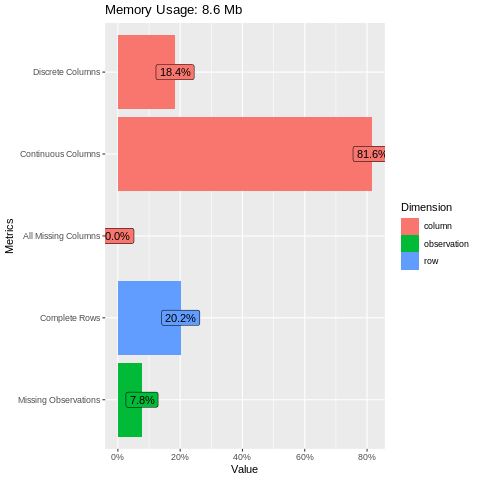

In [ ]:
%%R
library(DataExplorer)
# Resumen de la data gráficamente
plot_intro(df_r_web)

In [ ]:
df_py.head()

,data_Persona,data_productividad_per,data_Tcamp,data_sumCOD,data_sumHRSLB,data_GRADO2,data_sum_variedad_total_AL,data_sum_variedad_total_CC,data_sum_variedad_total_CP,data_sum_variedad_total_JS,...,data_total,data_bono_produc,data_otros_bono,dummies_Tsexo_Mujer,sede_cod,data_numero_asistentes,data_asistente_mediana_Tedad,data_asistente_mediana_numero_hijos,data_asistente_dias_empresa,cluster
0,5,268.347619,19,2817.65,10.5,PRIMARIA COMPLETA,12.31,0.00,0.0,0.0,...,51.99,0.49,0.00,0,Ica,2,NaN,NaN,NaN,1
1,11,80.000000,20,560.00,7.0,SECUNDARIA COMPLETA,0.00,0.00,0.0,0.0,...,94.77,4.70,0.00,0,Ica,1,45.0,0.0,2964.0,1
2,14,61.800000,20,618.00,10.0,SECUNDARIA COMPLETA,0.00,0.00,0.0,0.0,...,239.22,0.00,10.25,1,Ica,2,NaN,NaN,NaN,1
3,15,25.333333,20,228.00,9.0,SECUNDARIA COMPLETA,0.00,92.42,0.0,0.0,...,104.43,0.76,12.01,1,Ica,1,32.0,1.0,673.0,1
4,16,55.276000,19,138.19,2.5,SUPERIOR - TECNICO,26.87,0.00,0.0,0.0,...,26.87,0.00,0.00,0,Ica,1,28.0,0.0,NaN,1


In [ ]:
# Tipos de variables
df_py.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22907 entries, 0 to 22906
Data columns (total 49 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   data_Persona                         22907 non-null  int64  
 1   data_productividad_per               22907 non-null  float64
 2   data_Tcamp                           22907 non-null  int64  
 3   data_sumCOD                          22907 non-null  float64
 4   data_sumHRSLB                        22907 non-null  float64
 5   data_GRADO2                          18660 non-null  object 
 6   data_sum_variedad_total_AL           22907 non-null  float64
 7   data_sum_variedad_total_CC           22907 non-null  float64
 8   data_sum_variedad_total_CP           22907 non-null  float64
 9   data_sum_variedad_total_JS           22907 non-null  float64
 10  data_sum_variedad_total_MG           22907 non-null  float64
 11  data_sum_variedad_total_RG  

## Visualización de nulos

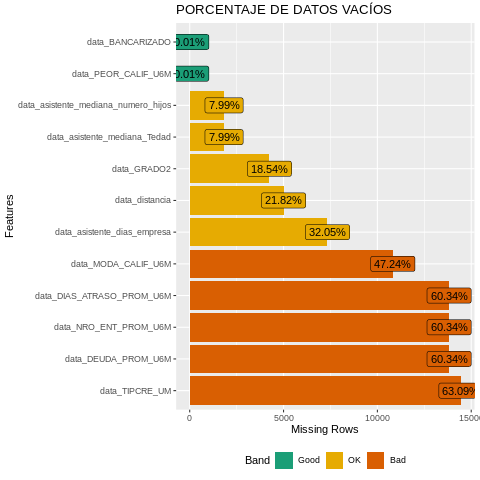

In [ ]:
%%R
library(DataExplorer)

# Valores faltantes o missing
plot_missing(df_r_web,
             missing_only = TRUE,
             title = "PORCENTAJE DE DATOS VACÍOS")

In [ ]:
# Indentificación: cantidad y porcentaje de valores nulo
missing_data = df_py.isnull().sum()
missing_percentage = df_py.isnull().mean() * 100

# df
missing_data_df = pd.DataFrame({
    'MissingValues': missing_data,
    'MissingPercentage': missing_percentage
})

# Solo NaN
missing_data_df = missing_data_df[missing_data_df['MissingValues'] > 0]

print("Columnas con valores nulos:\n", missing_data_df)

Columnas con valores nulos:
                                      MissingValues  MissingPercentage
data_GRADO2                                   4247          18.540184
data_DEUDA_PROM_U6M                          13822          60.339634
data_PEOR_CALIF_U6M                              2           0.008731
data_MODA_CALIF_U6M                          10822          47.243201
data_NRO_ENT_PROM_U6M                        13822          60.339634
data_TIPCRE_UM                               14453          63.094251
data_DIAS_ATRASO_PROM_U6M                    13822          60.339634
data_BANCARIZADO                                 2           0.008731
data_distancia                                4998          21.818658
data_asistente_mediana_Tedad                  1830           7.988824
data_asistente_mediana_numero_hijos           1830           7.988824
data_asistente_dias_empresa                   7341          32.046973


<Axes: >

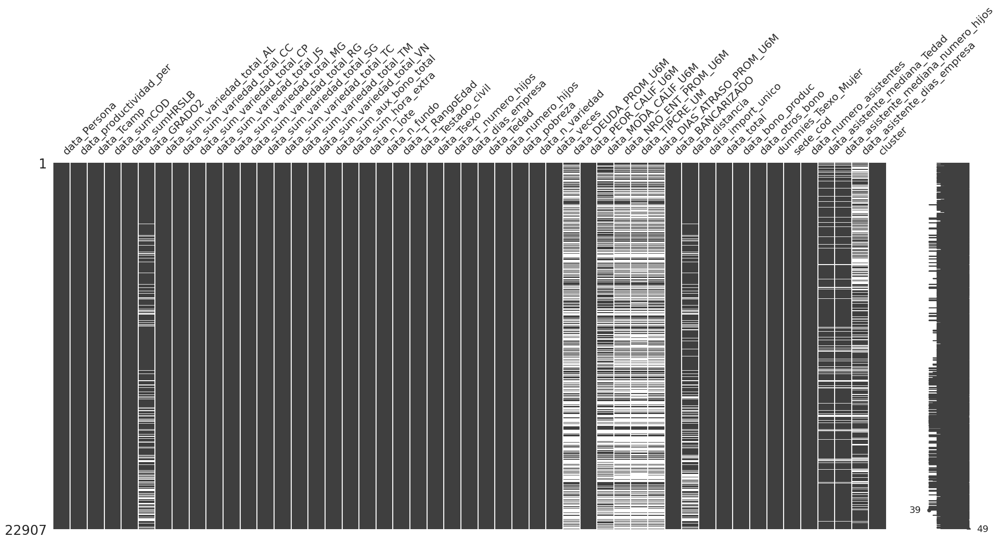

In [ ]:
msno.matrix(df_py)

# TRATAMIENTO DE DATOS

## Eliminación de columnas no representativas

In [ ]:
def excluir_columnas(df, columnas_excluidas):
  todas_las_columnas = df.columns.tolist()

  # Columnas que no están en la lista de exclusión
  columnas_seleccionadas = [col for col in todas_las_columnas if col not in columnas_excluidas]

  df = df[columnas_seleccionadas]
  return df

In [ ]:
# Columnas a excluir: No representativas
columnas_excluidas = ["data_Persona", "cluster"]

# Excluyendo columnas
df_cut = df_py.copy()
df_cut = excluir_columnas(df_cut, columnas_excluidas)

## Eliminación de columnas con alto porcentaje de vacíos

In [ ]:
# Excluir columnas con más del 60% de valores nulos
threshold = 60
columns_to_drop = missing_data_df[missing_data_df['MissingPercentage'] > threshold].index
df_cleaned = df_cut.drop(columns=columns_to_drop)

## Separación por tipo de datos

In [ ]:
skim(df_cleaned)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 22907  │ │ float64     │ 27    │                                                          │
│ │ Number of columns │ 43     │ │ int64       │ 8     │                                                          │
│ └───────────────────┴────────┘ │ string      │ 8     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_name           ┃ NA    ┃ NA %  ┃ mean   ┃ sd     ┃ p0     ┃ p25   ┃ p50   ┃ p75   ┃ p100   ┃ hist   ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━┩  │
│ │ data_productividad_pe │     0 │     0 │  65.41 │  100.3 │ 0.5714 │    25 │ 45.21 │ 79.03 │   3475 │   ▇    │  │
│ │ r                     │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_Tcamp            │     0 │     0 │  19.49 │    0.5 │     19 │    19 │    19 │    20 │     20 │ ▇    ▇ │  │
│ │ data_sumCOD           │     0 │     0 │   8581 │  13160 │      1 │   528 │  3268 │ 11480 │ 196700 │   ▇    │  │
│ │ data_sumHRSLB         │     0 │     0 │  112.8 │  117.6 │   0.25 │ 18.75 │  67.5 │ 177.8 │  550.5 │  ▇▃▂▁  │  │
│ │ data_sum_variedad_tot │     0 │     0 │  121.2 │  245.8 │      0 │     0 │     0 │ 106.4 │   1911 │  ▇▁▁   │  │
│ │ al_AL                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  78.83 │  224.1 │      0 │     0 │     0 │     0 │   3339 │   ▇    │  │
│ │ al_CC                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  8.019 │  41.91 │      0 │     0 │     0 │     0 │  567.8 │   ▇    │  │
│ │ al_CP                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  502.5 │   1679 │      0 │     0 │     0 │     0 │  20600 │   ▇    │  │
│ │ al_JS                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  57.73 │  207.2 │      0 │     0 │     0 │     0 │   3126 │   ▇    │  │
│ │ al_MG                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  126.3 │  394.2 │      0 │     0 │     0 │ 29.52 │   6299 │   ▇    │  │
│ │ al_RG                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  52.53 │  174.1 │      0 │     0 │     0 │     0 │   1773 │   ▇    │  │
│ │ al_SG                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  1.652 │  19.52 │      0 │     0 │     0 │     0 │  745.2 │   ▇    │  │
│ │ al_TC                 │       │       │        │        │        │       │       │       │        │        │  │
│ │ data_sum_variedad_tot │     0 │     0 │  296.7 │  54

In [ ]:
# Separar las columnas de tipo numéricas
df_num = df_cleaned.select_dtypes(include=['number'])

# Separar las columnas de tipo string
df_str = df_cleaned.select_dtypes(include=['object'])

## Datos numéricos

### Correlación

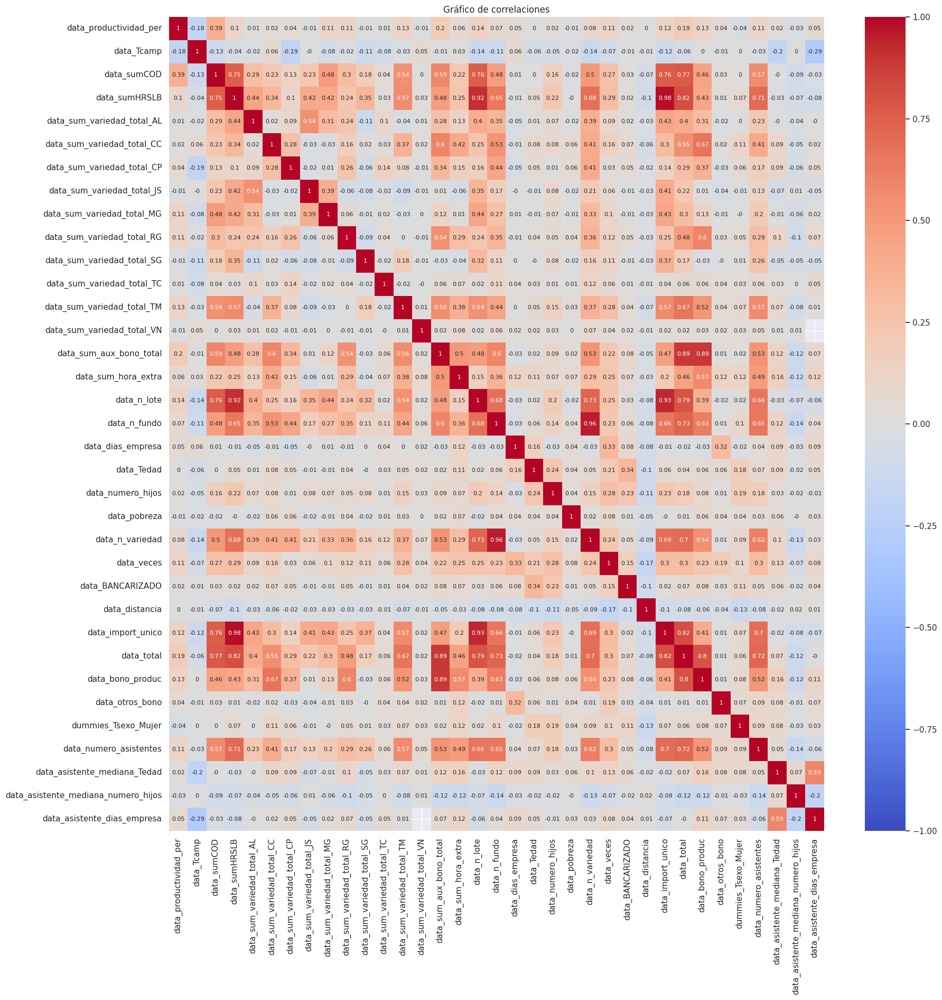

In [ ]:
# Calcular la matriz de correlación
df_num_corr = df_num.corr()

plt.figure(figsize=(20, 20))

sns.heatmap(np.round(df_num_corr,2),
            annot=True,
            cmap="coolwarm",
            vmin=-1,
            vmax=1,
            annot_kws={"size":8})

plt.title("Gráfico de correlaciones")
plt.show()

### Excluir columnas altamente correlacionadas

In [ ]:
# Se excluirá a las columnas que tengan 70% de correlación

# Columnas a excluir
columns_to_drop = set()

for col in df_num_corr.columns:
    if col in columns_to_drop:
        continue
    # Columnas con correlación mayor al 70%
    high_corr_cols = df_num_corr.index[df_num_corr[col].abs() > 0.70].tolist()
    high_corr_cols.remove(col)
    columns_to_drop.update(high_corr_cols)

print("Columnas excluidas:", columns_to_drop)

Columnas excluidas: {'data_n_variedad', 'data_n_lote', 'data_import_unico', 'data_bono_produc', 'data_total', 'data_sumHRSLB'}


In [ ]:
# Columnas a excluir: Con el reporte del correlograma
columnas_excluidas_cor = list(columns_to_drop)

# Excluyendo columnas que tienen alta correlación
df_num_reduced = excluir_columnas(df_num, columnas_excluidas_cor)

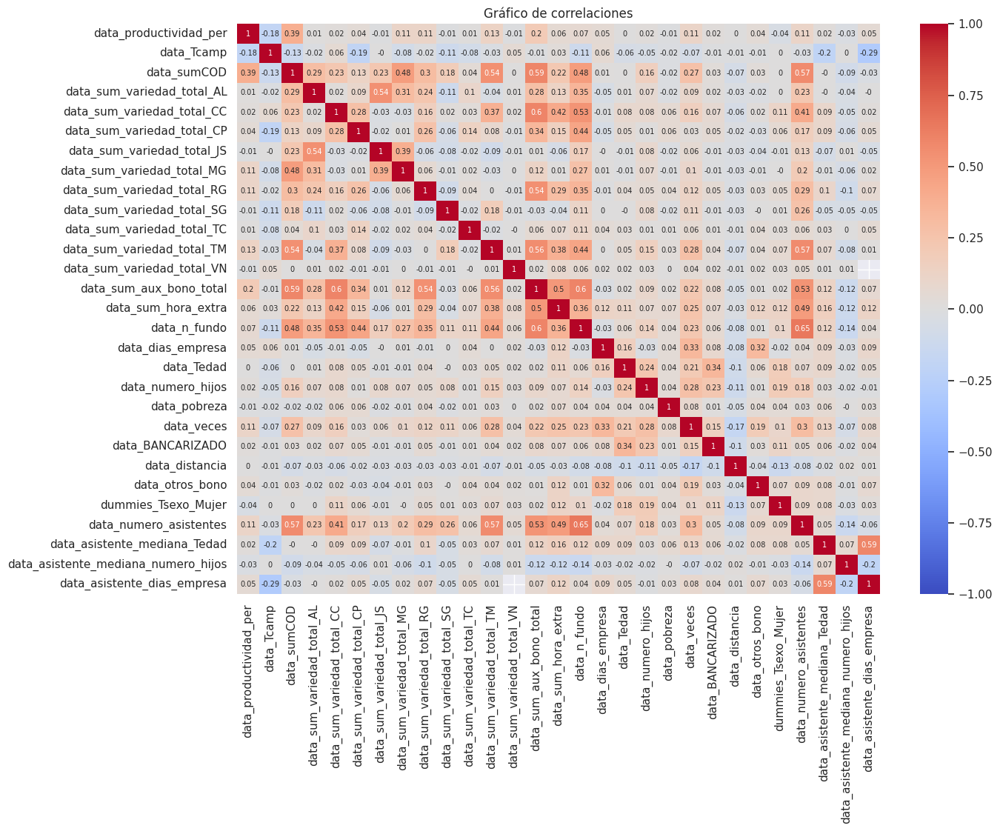

In [ ]:
# Visualización del correlograma
plt.figure(figsize=(14, 10))
sns.heatmap(np.round(df_num_reduced.corr(),2),
            annot=True,
            cmap="coolwarm",
            vmin=-1,
            vmax=1,
            annot_kws={"size": 7})
plt.title("Gráfico de correlaciones")
plt.show()

### Imputación de datos faltantes

In [ ]:
# Imputacion de los datos faltantes(NaN) con media truncada y mediana :
# Media trunca   : Float
# Media mediana  : Enteros
def imputar_faltantes_numerico(data, proportiontocut=0.1):
    data_imputada = data.copy()

    # Para cada columna, revisa el tipo de dato y imputa según corresponda
    for columna in data_imputada.columns:
        # Verificar si la columna contiene valores NaN
        if data_imputada[columna].isna().any():
            if data_imputada[columna].dtype == 'float64':
                # Calcula la media truncada para datos flotantes
                media_truncada = trim_mean(data_imputada[columna].dropna(), proportiontocut=proportiontocut)
                data_imputada[columna].fillna(media_truncada, inplace=True)
            elif data_imputada[columna].dtype == 'int64':
                # Calcula la mediana para datos enteros
                mediana_columna = data_imputada[columna].median()
                data_imputada[columna].fillna(mediana_columna, inplace=True)

    return data_imputada


In [ ]:
#@title Imputacion de datos faltantes con Random Forest
# Función para imputar datos numéricos con random forest
def imputar_faltantes_rf(df):
    data_imputada = df.copy()

    # Inicializar el modelo de regresión
    rgr = RandomForestRegressor(n_jobs=-1)
    mf = MissForest(rgr)
    df_imputado = mf.fit_transform(data_imputada)

    return df_imputado


In [ ]:
# Funciones para imputar vacíos:
'''
Imputación 01: imputar_faltantes_numerico
Imputación 02: imputar_faltantes_rf
'''

# APLICACION DE LA IMPUTACIÓN DE FALTANTES EN NUMÉRICOS
df_num_reduced_imputada_nan= imputar_faltantes_rf(df_num_reduced)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002874 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4028
[LightGBM] [Info] Number of data points in the train set: 11736, number of used features: 27
[LightGBM] [Info] Start training from score 0.820382
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3776
[LightGBM] [Info] Number of data points in the train set: 11736, number of used features: 27
[LightGBM] [Info] Start training from score 100.718919
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002524 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not eno

### Detección de outliers

In [3]:
def graficar_outliers(df, title_fontsize=12):
    num_columnas = 8
    num_filas = (len(df.columns) + num_columnas - 1) // num_columnas

    fig, axes = plt.subplots(num_filas, num_columnas, figsize=(15, num_filas * 2))

    axes_flat = axes.flatten()

    for i, (col, ax) in enumerate(zip(df.columns, axes_flat)):
        df.boxplot(column=[col], ax=ax)
        ax.set_title(f'{col}', fontsize=title_fontsize)
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.tick_params(labelbottom=False, labelleft=False)  # Ocultar las etiquetas de los ticks

    # Eliminar los ejes vacíos
    for i in range(len(df.columns), len(axes_flat)):
        fig.delaxes(axes_flat[i])

    plt.tight_layout()
    plt.show()


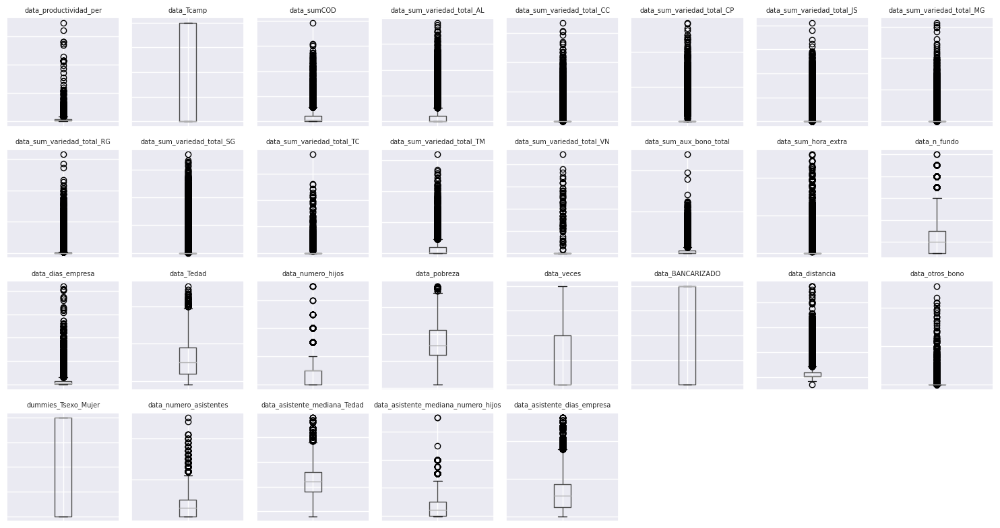

In [ ]:
graficar_outliers(df_num_reduced_imputada_nan, title_fontsize=7)

### Imputación de outliers

**Caso 1:** Imputacion de los outlier con mediana y media con While

Resultado: Sin outliers

- ***Si es Decimal(Float):*** Imputación con la media
- ***Si es Entero(Int):*** Imputación con la mediana

In [ ]:
# Imputacion de los outlier con mediana y media:
# Media   : Float
# Mediana  : Enteros
def imputar_outliers_median_mean(data_imputada):
    data_sin_outliers = data_imputada.copy()

    outliers_present = True

    while outliers_present:
        # Cuantiles
        Q1 = data_sin_outliers.quantile(0.25)
        Q3 = data_sin_outliers.quantile(0.75)

        # IQR
        IQR = Q3 - Q1

        # Limites
        limite_inferior = Q1 - 1.5 * IQR
        limite_superior = Q3 + 1.5 * IQR

        # Mascara
        mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

        # Verifica si aún hay outliers en el DataFrame
        outliers_present = mascara_atipicos.sum().sum() > 0

        # Reemplaza los outliers por NaN
        data_sin_outliers[mascara_atipicos] = np.nan

        # Para cada columna, revisa el tipo de dato y imputa según corresponda
        for columna in data_sin_outliers.columns:
            if data_sin_outliers[columna].dtype == 'int64':
                # Imputar con la mediana para datos enteros
                mediana_columna = data_sin_outliers[columna].median()
                data_sin_outliers[columna].fillna(mediana_columna, inplace=True)
            elif data_sin_outliers[columna].dtype == 'float64':
                # Imputar con la media para datos flotantes
                media_columna = data_sin_outliers[columna].mean()
                data_sin_outliers[columna].fillna(media_columna, inplace=True)

    return data_sin_outliers



**Caso 2:** Imputacion de los outlier con la media truncada sin redondear los enteros, con While

Resultado: Sin outliers

- ***Si es Decimal(Float):*** Imputación con la media truncada
- ***Si es Entero(Int):*** Imputación con la media truncada sin redondear

In [ ]:
# Imputacion de los outlier con media truncada sin redondear enteros:
# Media truncada   : Float y Enteros
def imputar_outliers_trim_mean(data_imputada, proportiontocut=0.1):
    data_sin_outliers = data_imputada.copy()

    outliers_present = True

    while outliers_present:
        # Cuantiles
        Q1 = data_sin_outliers.quantile(0.25)
        Q3 = data_sin_outliers.quantile(0.75)

        # IQR
        IQR = Q3 - Q1

        # Limites
        limite_inferior = Q1 - 1.5 * IQR
        limite_superior = Q3 + 1.5 * IQR

        # Mascara
        mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

        # Verifica si aún hay outliers en el DataFrame
        outliers_present = mascara_atipicos.sum().sum() > 0

        # Reemplaza los outliers por NaN
        data_sin_outliers[mascara_atipicos] = np.nan

        # Imputar todas las columnas con la media truncada
        for columna in data_sin_outliers.columns:
            media_truncada = trim_mean(data_sin_outliers[columna].dropna(), proportiontocut=proportiontocut)
            data_sin_outliers[columna].fillna(media_truncada, inplace=True)

    return data_sin_outliers


**Caso 3:** Imputacion de los outlier con la media truncada con redondear los enteros, con While

Resultado: Sin outliers

- ***Si es Decimal(Float):*** Imputación con la media truncada
- ***Si es Entero(Int):*** Imputación con la media truncada con redondear

In [ ]:
# Imputacion de los outlier con media truncada con redondear enteros:
# Media trunca   : Float
# Media truncada redondeada  : Enteros
def imputar_outliers_trim_mean_round(data_imputada, proportiontocut=0.1):
    data_sin_outliers = data_imputada.copy()

    outliers_present = True

    while outliers_present:
        # Cuantiles
        Q1 = data_sin_outliers.quantile(0.25)
        Q3 = data_sin_outliers.quantile(0.75)

        # IQR
        IQR = Q3 - Q1

        # Limites
        limite_inferior = Q1 - 1.5 * IQR
        limite_superior = Q3 + 1.5 * IQR

        # Mascara
        mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

        # Verifica si aún hay outliers en el DataFrame
        outliers_present = mascara_atipicos.sum().sum() > 0

        # Reemplaza los outliers por NaN
        data_sin_outliers[mascara_atipicos] = np.nan

        # Para cada columna, revisa el tipo de dato y imputa según corresponda
        for columna in data_sin_outliers.columns:
            media_truncada = trim_mean(data_sin_outliers[columna].dropna(), proportiontocut=proportiontocut)

            if data_sin_outliers[columna].dtype == 'int64':
                # Imputar con la media truncada redondeada para datos enteros
                data_sin_outliers[columna].fillna(round(media_truncada), inplace=True)
            elif data_sin_outliers[columna].dtype == 'float64':
                # Imputar con la media truncada para datos flotantes
                data_sin_outliers[columna].fillna(media_truncada, inplace=True)

    return data_sin_outliers

**Caso 4:** Imputacion de los outlier con mediana y media truncada con While

Resultado: Sin outliers

- ***Si es Decimal(Float):*** Imputación con la media truncada
- ***Si es Entero(Int):*** Imputación con la mediana

In [ ]:
# Imputacion de los outlier con mediana y media truncada:
# Media truncada   : Float
# Mediana  : Enteros
def imputar_outliers_median_trim_mean(data_imputada, proportiontocut=0.1):
    data_sin_outliers = data_imputada.copy()

    outliers_present = True

    while outliers_present:
        # Cuantiles
        Q1 = data_sin_outliers.quantile(0.25)
        Q3 = data_sin_outliers.quantile(0.75)

        # IQR
        IQR = Q3 - Q1

        # Limites
        limite_inferior = Q1 - 1.5 * IQR
        limite_superior = Q3 + 1.5 * IQR

        # Mascara
        mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

        # Verifica si aún hay outliers en el DataFrame
        outliers_present = mascara_atipicos.sum().sum() > 0

        # Reemplaza los outliers por NaN
        data_sin_outliers[mascara_atipicos] = np.nan

        # Para cada columna, revisa el tipo de dato y imputa según corresponda
        for columna in data_sin_outliers.columns:
            if data_sin_outliers[columna].dtype == 'int64':
                # Imputar con la mediana para datos enteros
                mediana_columna = data_sin_outliers[columna].median()
                data_sin_outliers[columna].fillna(mediana_columna, inplace=True)
            elif data_sin_outliers[columna].dtype == 'float64':
                # Imputar con la media truncada para datos flotantes
                media_truncada = trim_mean(data_sin_outliers[columna].dropna(), proportiontocut=proportiontocut)
                data_sin_outliers[columna].fillna(media_truncada, inplace=True)

    return data_sin_outliers


**Caso 5:** Imputacion de los outlier con mediana  con While

Resultado: Sin outliers

- ***Si es Decimal(Float):*** Imputación con la mediana
- ***Si es Entero(Int):*** Imputación con la mediana

In [ ]:
# Imputacion de los outlier con mediana:
# Mediana  : Float y Enteros
def imputar_outliers_median(data_imputada):
    data_sin_outliers = data_imputada.copy()

    outliers_present = True

    while outliers_present:
        # Cuantiles
        Q1 = data_sin_outliers.quantile(0.25)
        Q3 = data_sin_outliers.quantile(0.75)

        # IQR
        IQR = Q3 - Q1

        # Limites
        limite_inferior = Q1 - 1.5 * IQR
        limite_superior = Q3 + 1.5 * IQR

        # Mascara
        mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

        # Verifica si aún hay outliers en el DataFrame
        outliers_present = mascara_atipicos.sum().sum() > 0

        # Reemplaza los outliers por NaN
        data_sin_outliers[mascara_atipicos] = np.nan

        # Imputar todas las columnas con la mediana
        for columna in data_sin_outliers.columns:
            mediana_columna = data_sin_outliers[columna].median()
            data_sin_outliers[columna].fillna(mediana_columna, inplace=True)

    return data_sin_outliers

**Caso 6:** Imputacion de los outlier con media truncada redondeada y sin redondear, sin While

Resultado: Con menos outliers, para no cambiar la naturaleza de los datos

- ***Si es Decimal(Float):*** Imputación con la media truncada
- ***Si es Entero(Int):*** Imputación con la media truncada redondeada

In [ ]:
# Imputacion de los outlier con media truncada sin while:
# Media trunca   : Float
# Media truncada redondeada  : Enteros

def imputar_outliers_trim_mean_round_one_sin_while(data_imputada, proportiontocut=0.1):
    data_sin_outliers = data_imputada.copy()

    # Cuantiles
    Q1 = data_sin_outliers.quantile(0.25)
    Q3 = data_sin_outliers.quantile(0.75)

    # IQR
    IQR = Q3 - Q1

    # Limites
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR

    # Mascara
    mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

    # Reemplaza los outliers por NaN
    data_sin_outliers[mascara_atipicos] = np.nan

    # Para cada columna, revisa el tipo de dato y imputa según corresponda
    for columna in data_sin_outliers.columns:
        media_truncada = trim_mean(data_sin_outliers[columna].dropna(), proportiontocut=proportiontocut)

        if data_sin_outliers[columna].dtype == 'int64':
            # Imputar con la media truncada redondeada para datos enteros
            data_sin_outliers[columna].fillna(round(media_truncada), inplace=True)
        elif data_sin_outliers[columna].dtype == 'float64':
            # Imputar con la media truncada para datos flotantes
            data_sin_outliers[columna].fillna(media_truncada, inplace=True)

    return data_sin_outliers


**Caso 7:** Imputacion de los outlier con media truncada y mediana sin While

Resultado: Con menos outliers, para no cambiar la naturaleza de los datos

- ***Si es Decimal(Float):*** Imputación con la media truncada
- ***Si es Entero(Int):*** Imputación con la mediana

In [ ]:
# Imputacion de los outlier con media truncada y mediana sin while:
# Media trunca   : Float
# Media mediana  : Enteros

def imputar_outliers_median_trim_mean_sin_while(data_imputada, proportiontocut=0.1):
    data_sin_outliers = data_imputada.copy()

    # Cuantiles
    Q1 = data_sin_outliers.quantile(0.25)
    Q3 = data_sin_outliers.quantile(0.75)

    # IQR
    IQR = Q3 - Q1

    # Limites
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR

    # Mascara
    mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

    # Reemplaza los outliers por NaN
    data_sin_outliers[mascara_atipicos] = np.nan

    # Para cada columna, revisa el tipo de dato y imputa según corresponda
    for columna in data_sin_outliers.columns:
        media_truncada = trim_mean(data_sin_outliers[columna].dropna(), proportiontocut=proportiontocut)
        # Imputar con la mediana para datos enteros
        mediana_columna = data_sin_outliers[columna].median()

        if data_sin_outliers[columna].dtype == 'int64':
            # Imputar con la mediama para datos enteros
            data_sin_outliers[columna].fillna(mediana_columna, inplace=True)
        elif data_sin_outliers[columna].dtype == 'float64':
            # Imputar con la media truncada para datos flotantes
            data_sin_outliers[columna].fillna(media_truncada, inplace=True)

    return data_sin_outliers


**Caso 8:** Imputacion de los outlier, extra outliers, obtiene su media truncada y los reemplaza a todos los outliers, solo con decimales pero  sin While

Resultado: Con menos outliers, para no cambiar la naturaleza de los datos

- ***Si es Decimal(Float):*** Imputación con la media truncada de los outliers

In [57]:
# Imputacion de los outlier con media truncada de los outliers sin while:
# Media trunca  de los outliers: Float

def imputar_outliers_trim_mean_out_sin_while(data_imputada, proportiontocut=0.1):
    data_sin_outliers = data_imputada.copy()

    # Cuantiles
    Q1 = data_sin_outliers.quantile(0.25)
    Q3 = data_sin_outliers.quantile(0.75)

    # IQR
    IQR = Q3 - Q1

    # Límites
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR

    # Máscara para detectar outliers
    mascara_atipicos = ((data_sin_outliers < limite_inferior) | (data_sin_outliers > limite_superior))

    # Para cada columna de tipo float64, calcular la media truncada de los outliers y reemplazarlos
    for columna in data_sin_outliers.columns:
        if data_sin_outliers[columna].dtype == 'float64':
            # Seleccionar los valores outliers
            outliers = data_sin_outliers.loc[mascara_atipicos[columna], columna]

            # Calcular la media truncada de los outliers
            media_truncada_outliers = trim_mean(outliers.dropna(), proportiontocut=proportiontocut)

            # Reemplazar los outliers con la media truncada calculada
            data_sin_outliers.loc[mascara_atipicos[columna], columna] = media_truncada_outliers

    return data_sin_outliers


**Caso 9:** Imputación de un porcentaje outliers más altos y más bajos mediante la media truncada, solo aplica con decimales pero  sin While

Resultado: Con menos outliers, para no cambiar la naturaleza de los datos

- ***Si es Decimal(Float):*** Imputación con la media truncada de los outliers a los outliers más altos y más bajos, según el porcentaje de corte.

In [58]:
def imputar_outliers_trim_mean_top_bottom_sin_while(data_imputada, trim=0.1, umbralUp=0.1, umbralLow=0.1):
    data_sin_outliers = data_imputada.copy()

    # Cuantiles
    Q1 = data_sin_outliers.quantile(0.25)
    Q3 = data_sin_outliers.quantile(0.75)

    # IQR
    IQR = Q3 - Q1

    # Límites
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR

    # Para cada columna de tipo float64, detectar y reemplazar los outliers
    for columna in data_sin_outliers.columns:
        if data_sin_outliers[columna].dtype == 'float64':
            # Outliers mayores al límite superior y menores al límite inferior
            outliers_superiores = data_sin_outliers[columna][data_sin_outliers[columna] > limite_superior[columna]]
            outliers_inferiores = data_sin_outliers[columna][data_sin_outliers[columna] < limite_inferior[columna]]

            # Calcular el número de outliers a cortar (umbrales de corte para los outliers superiores e inferiores)
            n_superiores = int(umbralUp * len(outliers_superiores))
            n_inferiores = int(umbralLow * len(outliers_inferiores))

            # Ordenar los outliers
            outliers_superiores_sorted = outliers_superiores.sort_values(ascending=False)
            outliers_inferiores_sorted = outliers_inferiores.sort_values()

            # Seleccionar el porcentaje de outliers más altos y más bajos para cortar
            cortar_superiores = outliers_superiores_sorted[:n_superiores]
            cortar_inferiores = outliers_inferiores_sorted[:n_inferiores]

            # Calcular la media truncada de los outliers restantes
            if len(outliers_superiores_sorted[n_superiores:]) > 0:
                media_truncada_superiores = trim_mean(outliers_superiores_sorted[n_superiores:], proportiontocut=trim)
            else:
                media_truncada_superiores = outliers_superiores.mean()

            if len(outliers_inferiores_sorted[n_inferiores:]) > 0:
                media_truncada_inferiores = trim_mean(outliers_inferiores_sorted[n_inferiores:], proportiontocut=trim)
            else:
                media_truncada_inferiores = outliers_inferiores.mean()

            # Reemplazar los outliers cortados con la media truncada calculada
            data_sin_outliers.loc[cortar_superiores.index, columna] = media_truncada_superiores
            data_sin_outliers.loc[cortar_inferiores.index, columna] = media_truncada_inferiores

    return data_sin_outliers


**Caso 10:** Imputación de un porcentaje outliers más altos y más bajos mediante la media truncada para decimales y con mediana truncada para enteros, solo aplica con decimales pero  sin While

Resultado: Con menos outliers, para no cambiar la naturaleza de los datos

- ***Si es Decimal(Float):*** Imputación con la media truncada de los outliers a los outliers más altos y más bajos, según el porcentaje de corte.
- ***Si es Entero(Int):*** Imputación con la mediana truncada de los outliers a los outliers más altos y más bajos, según el porcentaje de corte.

In [50]:
from scipy.stats import trim_mean, scoreatpercentile
import numpy as np
import pandas as pd

def imputar_outliers_trim_mean_median_top_bottom_sin_while(data_imputada,
                                                    umbral_Up=0.1,
                                                    umbral_Low=0.1,
                                                    trimMean_Up=0.1,
                                                    trimMean_Low=0.1):
    data_sin_outliers = data_imputada.copy()

    # Cuantiles
    Q1 = data_sin_outliers.quantile(0.25)
    Q3 = data_sin_outliers.quantile(0.75)

    # IQR
    IQR = Q3 - Q1

    # Límites
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR

    # Para cada columna, detectar y reemplazar los outliers
    for columna in data_sin_outliers.columns:
        if data_sin_outliers[columna].dtype == 'float64':
            # Outliers mayores al límite superior y menores al límite inferior
            outliers_superiores = data_sin_outliers[columna][data_sin_outliers[columna] > limite_superior[columna]]
            outliers_inferiores = data_sin_outliers[columna][data_sin_outliers[columna] < limite_inferior[columna]]

            # Calcular el número de outliers a cortar
            n_superiores = int(umbral_Up * len(outliers_superiores))
            n_inferiores = int(umbral_Low * len(outliers_inferiores))

            # Ordenar los outliers
            outliers_superiores_sorted = outliers_superiores.sort_values(ascending=False)
            outliers_inferiores_sorted = outliers_inferiores.sort_values(ascending=True)

            # Seleccionar el porcentaje de outliers más altos y más bajos para cortar
            cortar_superiores = outliers_superiores_sorted[:n_superiores]
            cortar_inferiores = outliers_inferiores_sorted[:n_inferiores]

            # Calcular la media truncada de los outliers restantes
            if len(outliers_superiores_sorted[n_superiores:]) > 0:
                media_truncada_superiores = trim_mean(outliers_superiores_sorted[n_superiores:], proportiontocut=trimMean_Up)
            else:
                media_truncada_superiores = outliers_superiores.mean()

            if len(outliers_inferiores_sorted[n_inferiores:]) > 0:
                media_truncada_inferiores = trim_mean(outliers_inferiores_sorted[n_inferiores:], proportiontocut=trimMean_Low)
            else:
                media_truncada_inferiores = outliers_inferiores.mean()

            # Reemplazar los outliers cortados con la media truncada calculada
            data_sin_outliers.loc[cortar_superiores.index, columna] = media_truncada_superiores
            data_sin_outliers.loc[cortar_inferiores.index, columna] = media_truncada_inferiores

        elif data_sin_outliers[columna].dtype == 'int64':
            # Outliers mayores al límite superior y menores al límite inferior
            outliers_superiores = data_sin_outliers[columna][data_sin_outliers[columna] > limite_superior[columna]]
            outliers_inferiores = data_sin_outliers[columna][data_sin_outliers[columna] < limite_inferior[columna]]

            # Calcular el número de outliers a cortar
            n_superiores = int(umbral_Up * len(outliers_superiores))
            n_inferiores = int(umbral_Low * len(outliers_inferiores))

            # Ordenar los outliers
            outliers_superiores_sorted = outliers_superiores.sort_values(ascending=False)
            outliers_inferiores_sorted = outliers_inferiores.sort_values(ascending=True)

            # Seleccionar el porcentaje de outliers más altos y más bajos para cortar
            cortar_superiores = outliers_superiores_sorted[:n_superiores]
            cortar_inferiores = outliers_inferiores_sorted[:n_inferiores]

            # Calcular la mediana truncada de los outliers restantes
            if len(outliers_superiores_sorted[n_superiores:]) > 0:
                median_truncada_superiores = np.median(outliers_superiores_sorted[n_superiores:])
            else:
                median_truncada_superiores = np.median(outliers_superiores)

            if len(outliers_inferiores_sorted[n_inferiores:]) > 0:
                median_truncada_inferiores = np.median(outliers_inferiores_sorted[n_inferiores:])
            else:
                median_truncada_inferiores = np.median(outliers_inferiores)

            # Reemplazar los outliers cortados con la mediana truncada calculada
            data_sin_outliers.loc[cortar_superiores.index, columna] = median_truncada_superiores
            data_sin_outliers.loc[cortar_inferiores.index, columna] = median_truncada_inferiores

    return data_sin_outliers


**Caso 11:** Imputación de un porcentaje de outliers más altos y más bajos mediante la media truncada para decimales y con mediana truncada para enteros

Resultado: Reducción de outliers para mantener la naturaleza de los datos.

- ***Si es Decimal (Float):*** Imputación con la media truncada de los outliers restantes a los outliers más altos y más bajos, según el porcentaje de corte.
- ***Si es Entero (Int):*** Imputación con la mediana truncada de los outliers restantes a los outliers más altos y más bajos, según el porcentaje de corte.

In [45]:
from scipy.stats import trim_mean
import numpy as np
import pandas as pd

def zeta_imputer_robust(data_imputada,
                        umbral_Up=0.1,
                        umbral_Low=0.1,
                        trimMean_Up=0.1,
                        trimMean_Low=0.1,
                        trimMedian_Up=0.1,
                        trimMedian_Low=0.1):
    data_sin_outliers = data_imputada.copy()

    # Cuantiles
    Q1 = data_sin_outliers.quantile(0.25)
    Q3 = data_sin_outliers.quantile(0.75)

    # IQR
    IQR = Q3 - Q1

    # Límites
    limite_inferior = Q1 - 1.5 * IQR
    limite_superior = Q3 + 1.5 * IQR

    # Para cada columna, detectar y reemplazar los outliers
    for columna in data_sin_outliers.columns:
        if data_sin_outliers[columna].dtype == 'float64':
            # Outliers mayores al límite superior y menores al límite inferior
            outliers_superiores = data_sin_outliers[columna][data_sin_outliers[columna] > limite_superior[columna]]
            outliers_inferiores = data_sin_outliers[columna][data_sin_outliers[columna] < limite_inferior[columna]]

            # Calcular el número de outliers a cortar
            n_superiores = int(umbral_Up * len(outliers_superiores))
            n_inferiores = int(umbral_Low * len(outliers_inferiores))

            # Ordenar los outliers
            outliers_superiores_sorted = outliers_superiores.sort_values(ascending=False)
            outliers_inferiores_sorted = outliers_inferiores.sort_values()

            # Seleccionar el porcentaje de outliers más altos y más bajos para cortar
            cortar_superiores = outliers_superiores_sorted[:n_superiores]
            cortar_inferiores = outliers_inferiores_sorted[:n_inferiores]

            # Calcular la media truncada de los outliers restantes
            if len(outliers_superiores_sorted[n_superiores:]) > 0:
                media_truncada_superiores = trim_mean(outliers_superiores_sorted[n_superiores:], proportiontocut=trimMean_Up)
            else:
                media_truncada_superiores = outliers_superiores.mean()

            if len(outliers_inferiores_sorted[n_inferiores:]) > 0:
                media_truncada_inferiores = trim_mean(outliers_inferiores_sorted[n_inferiores:], proportiontocut=trimMean_Low)
            else:
                media_truncada_inferiores = outliers_inferiores.mean()

            # Reemplazar los outliers cortados con la media truncada calculada
            data_sin_outliers.loc[cortar_superiores.index, columna] = media_truncada_superiores
            data_sin_outliers.loc[cortar_inferiores.index, columna] = media_truncada_inferiores

        elif data_sin_outliers[columna].dtype == 'int64':
            # Outliers mayores al límite superior y menores al límite inferior
            outliers_superiores = data_sin_outliers[columna][data_sin_outliers[columna] > limite_superior[columna]]
            outliers_inferiores = data_sin_outliers[columna][data_sin_outliers[columna] < limite_inferior[columna]]

            # Calcular el número de outliers a cortar
            n_superiores = int(umbral_Up * len(outliers_superiores))
            n_inferiores = int(umbral_Low * len(outliers_inferiores))

            # Ordenar los outliers
            outliers_superiores_sorted = outliers_superiores.sort_values(ascending=False)
            outliers_inferiores_sorted = outliers_inferiores.sort_values()

            # Seleccionar el porcentaje de outliers más altos y más bajos para cortar
            cortar_superiores = outliers_superiores_sorted[:n_superiores]
            cortar_inferiores = outliers_inferiores_sorted[:n_inferiores]

            # Calcular la mediana truncada de los outliers restantes
            if len(outliers_superiores_sorted[n_superiores:]) > 0:
                # Aplicar corte basado en trimMedian_Up para outliers superiores
                lower_bound_superiores = int(trimMedian_Up * len(outliers_superiores_sorted[n_superiores:]))
                upper_bound_superiores = len(outliers_superiores_sorted[n_superiores:]) - lower_bound_superiores
                median_truncada_superiores = np.median(outliers_superiores_sorted[n_superiores:].iloc[lower_bound_superiores:upper_bound_superiores])
            else:
                median_truncada_superiores = np.median(outliers_superiores)

            if len(outliers_inferiores_sorted[n_inferiores:]) > 0:
                # Aplicar corte basado en trimMedian_Low para outliers inferiores
                lower_bound_inferiores = int(trimMedian_Low * len(outliers_inferiores_sorted[n_inferiores:]))
                upper_bound_inferiores = len(outliers_inferiores_sorted[n_inferiores:]) - lower_bound_inferiores
                median_truncada_inferiores = np.median(outliers_inferiores_sorted[n_inferiores:].iloc[lower_bound_inferiores:upper_bound_inferiores])
            else:
                median_truncada_inferiores = np.median(outliers_inferiores)

            # Reemplazar los outliers cortados con la mediana truncada calculada
            data_sin_outliers.loc[cortar_superiores.index, columna] = median_truncada_superiores
            data_sin_outliers.loc[cortar_inferiores.index, columna] = median_truncada_inferiores

    return data_sin_outliers



In [32]:
import matplotlib.pyplot as plt

def detectar_outliers_valores(data, threshold=1.5):
    """
    Detecta outliers en un DataFrame utilizando el método IQR (Interquartile Range).

    Parámetros:
    data (pd.DataFrame): DataFrame con los datos a analizar.
    threshold (float): Umbral para definir los outliers (por defecto es 1.5).

    Retorna:
    dict: Diccionario con los nombres de las columnas y los valores de los outliers detectados.
    """
    outliers_valores = {}

    for columna in data.columns:
        # Cuartiles y IQR
        Q1 = data[columna].quantile(0.25)
        Q3 = data[columna].quantile(0.75)
        IQR = Q3 - Q1

        # Límites superior e inferior
        limite_inferior = Q1 - threshold * IQR
        limite_superior = Q3 + threshold * IQR

        # Detección de outliers
        outliers = data[columna][(data[columna] < limite_inferior) | (data[columna] > limite_superior)]
        outliers_valores[columna] = outliers

    return outliers_valores

In [61]:
import numpy as np
import pandas as pd

# Simulación de un DataFrame con 100 outliers tanto superiores como inferiores
np.random.seed(42)

# Generación de datos normales
data_normal_decimal = np.random.normal(loc=50, scale=10, size=500)
data_normal_entero = np.random.normal(loc=50, scale=10, size=500).astype(int)

# Introducción de 100 outliers superiores e inferiores
outliers_superiores_decimal = np.random.normal(loc=150, scale=5, size=50)
outliers_inferiores_decimal = np.random.normal(loc=-50, scale=5, size=50)
outliers_superiores_entero = np.random.normal(loc=150, scale=5, size=50).astype(int)
outliers_inferiores_entero = np.random.normal(loc=-50, scale=5, size=50).astype(int)

# Combinación de datos
data_decimal = np.concatenate((data_normal_decimal, outliers_superiores_decimal, outliers_inferiores_decimal))
data_entero = np.concatenate((data_normal_entero, outliers_superiores_entero, outliers_inferiores_entero))

# Creación del DataFrame
df_outliers = pd.DataFrame({
    'columna_decimal': data_decimal,
    'columna_entero': data_entero
})

# Mostrar el DataFrame simulado
print(df_outliers.head())
print(df_outliers.tail())


   columna_decimal  columna_entero
0        54.967142              59
1        48.617357              69
2        56.476885              36
3        65.230299              55
4        47.658466              43
     columna_decimal  columna_entero
595       -50.403583             -47
596       -49.606824             -50
597       -59.991003             -47
598       -45.418362             -48
599       -48.267558             -43


In [68]:
pd.DataFrame(detectar_outliers_valores(data_imputada))

,columna_decimal,columna_entero
74,23.802549,NaN
113,74.632421,NaN
125,71.904556,NaN
179,77.201692,NaN
220,73.146586,NaN
...,...,...
595,NaN,-47.0
596,NaN,-50.0
597,NaN,-47.0
598,NaN,-48.0


In [ ]:
# Funciones para imputar outliers:
'''
Caso 01: imputar_outliers_median_mean
Caso 02: imputar_outliers_trim_mean
Caso 03: imputar_outliers_trim_mean_round
Caso 04: imputar_outliers_median_trim_mean
Caso 05: imputar_outliers_median
Caso 06: imputar_outliers_trim_mean_round_one_sin_while
Caso 07: imputar_outliers_median_trim_mean_sin_while
Caso 08: imputar_outliers_trim_mean_out_sin_while
Caso 09: imputar_outliers_trim_mean_top_bottom_sin_while
Caso 10: imputar_outliers_trim_mean_median_top_bottom_sin_while
Caso 11: zeta_imputer_robust
'''

# APLICACION DE LA IMPUTACIÓN DE OUTLIERS
df_num_imputada_con_out = imputar_outliers_trim_mean_out_sin_while(df_num_reduced_imputada_nan)
df_num_imputada_sin_out = imputar_outliers_median_trim_mean(df_num_reduced_imputada_nan)

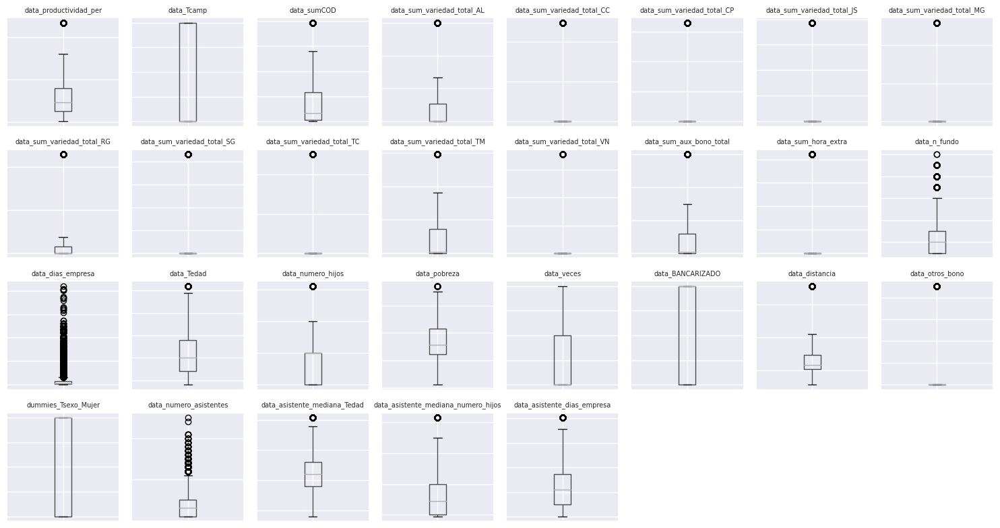

In [ ]:
# Con outliers
graficar_outliers(df_num_imputada_con_out, title_fontsize=7)

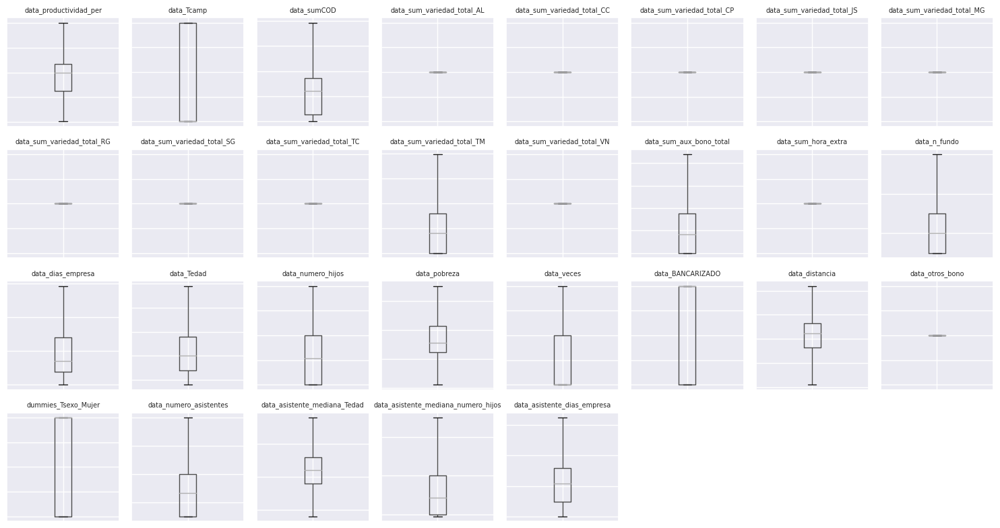

In [ ]:
# Sin outliers
graficar_outliers(df_num_imputada_sin_out, title_fontsize=7)

## Datos categóricos

In [ ]:
# Reemplazos para la columna 'data_Testado_civil'
reemplazos_estado_civil = {
    'Casado(a)/conviviente/unionlibre': 'Casado(a)',
    'Divorciado(a)/separado(a)': 'Divorciado(a)'
}

# Reemplazos para la columna 'data_PEOR_CALIF_U6M'
reemplazos_peor_calif = {
    '0.NORMAL': 'NORMAL',
    '1.CPP': 'CPP',
    '2.DEFICIENTE': 'DEFICIENTE',
    '3.DUDOSO': 'DUDOSO',
    '4.EN PERDIDA': 'EN PERDIDA',
    '8.SIN CALIFICACION': 'SIN CALIFICACION',
}

# Reemplazos para la columna 'data_MODA_CALIF_U6M'
reemplazos_moda_calif = {
    '0.NORMAL': 'NORMAL',
    '1.CPP': 'CPP',
    '2.DEFICIENTE': 'DEFICIENTE',
    '3.DUDOSO': 'DUDOSO',
    '4.EN PERDIDA': 'EN PERDIDA'
}

# Reemplazo
df_str['data_Testado_civil'] = df_str['data_Testado_civil'].replace(reemplazos_estado_civil)
df_str['data_PEOR_CALIF_U6M'] = df_str['data_PEOR_CALIF_U6M'].replace(reemplazos_peor_calif)
df_str['data_MODA_CALIF_U6M'] = df_str['data_MODA_CALIF_U6M'].replace(reemplazos_moda_calif)

### Imputación de datos faltantes

In [ ]:
# Imputacion de datos categóricos faltantes con la moda:

def imputar_categoricos_moda(df):

    df_imputado = df.copy()

    for columna in df_imputado.columns:
        if df_imputado[columna].dtype == 'object' or pd.api.types.is_categorical_dtype(df_imputado[columna]):
            # Calcular la moda
            moda_columna = df_imputado[columna].mode().iloc[0]
            # Reemplazar los valores faltantes con la moda
            df_imputado[columna].fillna(moda_columna, inplace=True)

    return df_imputado

In [ ]:
#@title Imputacion de datos faltantes con Random Forest
# Función para imputar datos categóricos con random forest
def imputar_faltantes_cat_rf(df):
    data_imputada = df.copy()

    # Inicializar el modelo de clasificación
    clf = RandomForestClassifier(n_jobs=-1)
    mf = MissForest(clf)
    # Separacion de categóricos
    cat_cols = data_imputada.select_dtypes(include=[object]).columns.tolist()
    # Imputación categóricos
    df_imputado = mf.fit_transform(
    data_imputada,
    categorical=cat_cols
    )

    return df_imputado

In [ ]:
# Funciones para imputar vacíos:
'''
Imputación 01: imputar_categoricos_moda
Imputación 02: imputar_faltantes_cat_rf
'''

# APLICACION DE LA IMPUTACIÓN DE FALTANTES EN CATEGÓRICOS
df_str_imputada_nan = imputar_faltantes_cat_rf(df_str)

## Imputacion de datos faltantes con Random Forest numéricos y categóricos

In [ ]:
# Concatenación de data a imputar
df_num_reduced_str = pd.concat([df_num_reduced, df_str], axis=1)

In [ ]:
# Imputación de datos faltantes
clf = RandomForestClassifier(n_jobs=-1)
rgr = RandomForestRegressor(n_jobs=-1)

mf = MissForest(clf, rgr)

cat_cols = df_num_reduced_str.select_dtypes(include=[object]).columns.tolist()

df_num_reduced_str_imputed = mf.fit_transform(
    df_num_reduced_str,
    categorical=cat_cols
    )

## Data tratada para exportar

In [ ]:
# Data tratada(seleccionar)
df_combined_con_out = pd.concat([df_num_imputada_con_out, df_str_imputada_nan], axis=1)
df_combined_sin_out = pd.concat([df_num_imputada_sin_out, df_str_imputada_nan], axis=1)

In [ ]:
df_combined_con_out.head(3)

,data_productividad_per,data_Tcamp,data_sumCOD,data_sum_variedad_total_AL,data_sum_variedad_total_CC,data_sum_variedad_total_CP,data_sum_variedad_total_JS,data_sum_variedad_total_MG,data_sum_variedad_total_RG,data_sum_variedad_total_SG,...,data_asistente_mediana_numero_hijos,data_asistente_dias_empresa,data_GRADO2,data_T_RangoEdad,data_Testado_civil,data_Tsexo,data_T_numero_hijos,data_PEOR_CALIF_U6M,data_MODA_CALIF_U6M,sede_cod
0,233.528343,19,2817.65,12.31,0.0,0.0,0.0,259.789154,0.0,0.0,...,0.803795,1278.905216,PRIMARIA COMPLETA,MAS DE 50,Casado(a),Hombre,sin hijos,DEFICIENTE,DEFICIENTE,Ica
1,80.000000,20,560.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.000000,2964.000000,SECUNDARIA COMPLETA,DE 31 A 50,Casado(a),Hombre,sin hijos,NORMAL,NORMAL,Ica
2,61.800000,20,618.00,0.00,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.889344,1337.530035,SECUNDARIA COMPLETA,DE 31 A 50,Soltero(a),Mujer,sin hijos,EN PERDIDA,EN PERDIDA,Ica


In [ ]:
df_combined_sin_out.head(3)

,data_productividad_per,data_Tcamp,data_sumCOD,data_sum_variedad_total_AL,data_sum_variedad_total_CC,data_sum_variedad_total_CP,data_sum_variedad_total_JS,data_sum_variedad_total_MG,data_sum_variedad_total_RG,data_sum_variedad_total_SG,...,data_asistente_mediana_numero_hijos,data_asistente_dias_empresa,data_GRADO2,data_T_RangoEdad,data_Testado_civil,data_Tsexo,data_T_numero_hijos,data_PEOR_CALIF_U6M,data_MODA_CALIF_U6M,sede_cod
0,47.147527,19,2817.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.803795,1278.905216,PRIMARIA COMPLETA,MAS DE 50,Casado(a),Hombre,sin hijos,DEFICIENTE,DEFICIENTE,Ica
1,80.000000,20,560.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,2964.000000,SECUNDARIA COMPLETA,DE 31 A 50,Casado(a),Hombre,sin hijos,NORMAL,NORMAL,Ica
2,61.800000,20,618.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.889344,1337.530035,SECUNDARIA COMPLETA,DE 31 A 50,Soltero(a),Mujer,sin hijos,EN PERDIDA,EN PERDIDA,Ica


                                             |          | [  0%]   00:00 -> (? left)


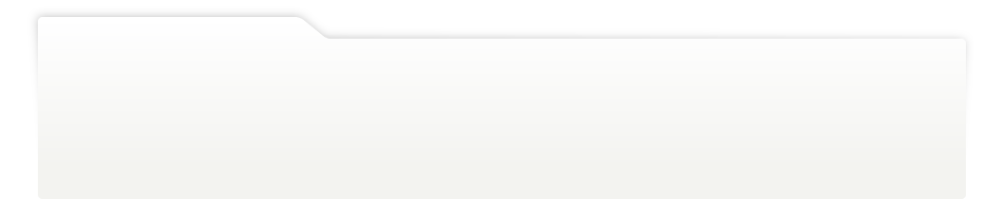
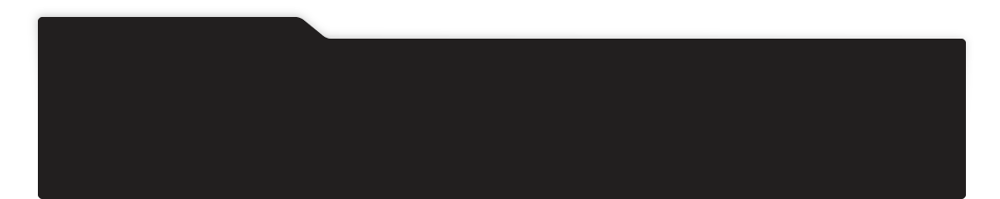
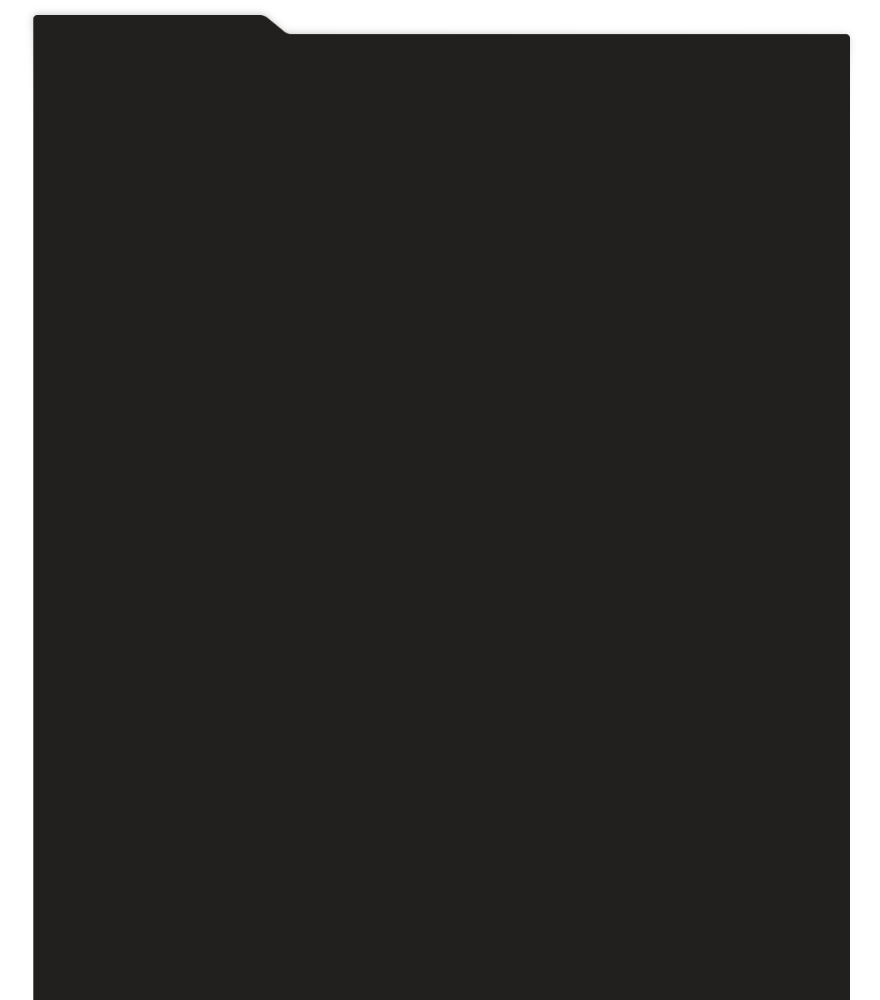
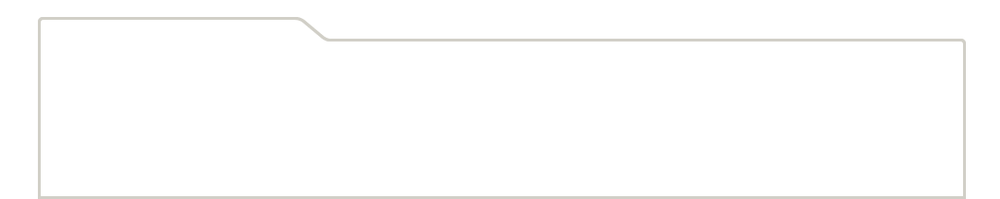
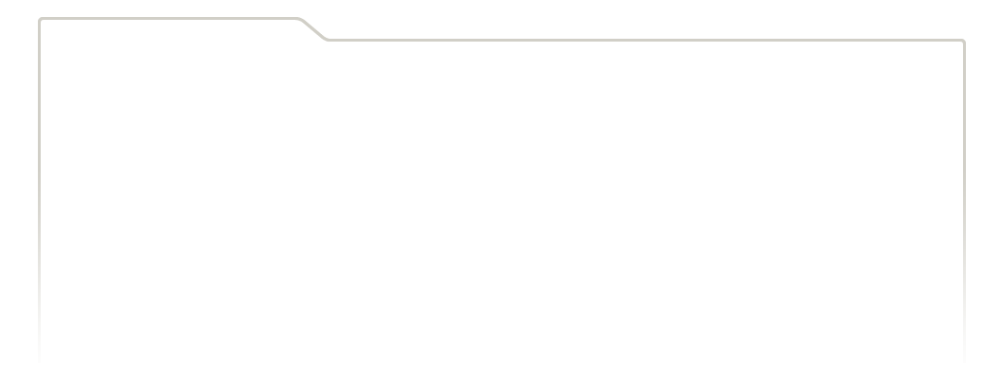
...
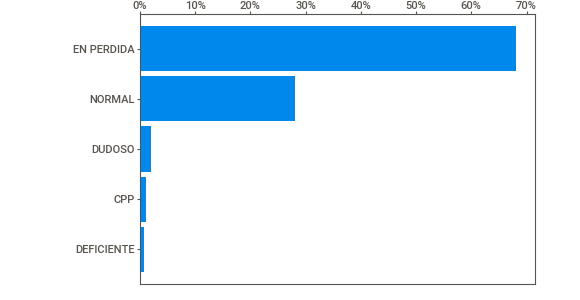
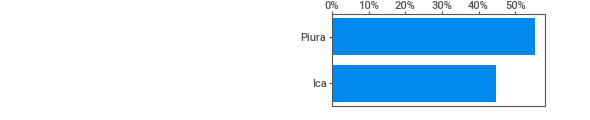
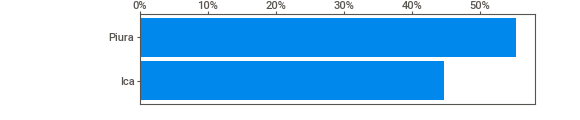
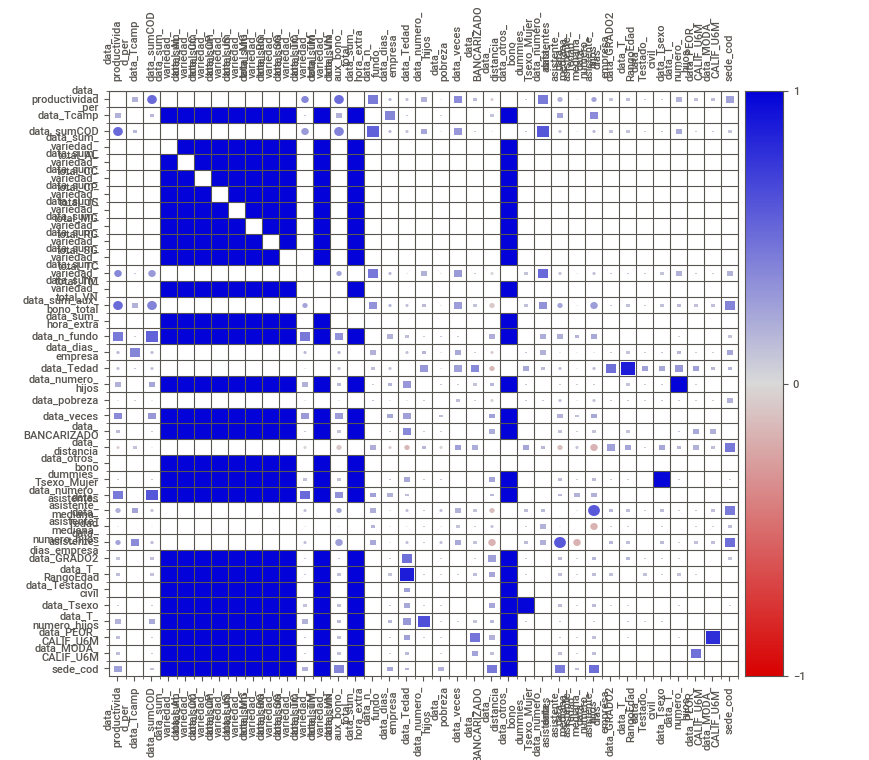
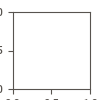

In [ ]:
# Creamos nuestro primer reporte
my_report_sin_out = sv.analyze(df_combined_sin_out)

# Lo mostramos en el notebook
my_report_sin_out.show_notebook(h = 'full')

In [ ]:
my_report_sin_out.show_html('my_report_sin_out.html')

Report my_report_sin_out.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


                                             |          | [  0%]   00:00 -> (? left)


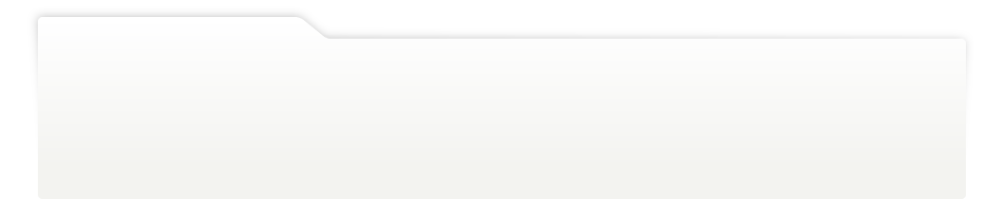
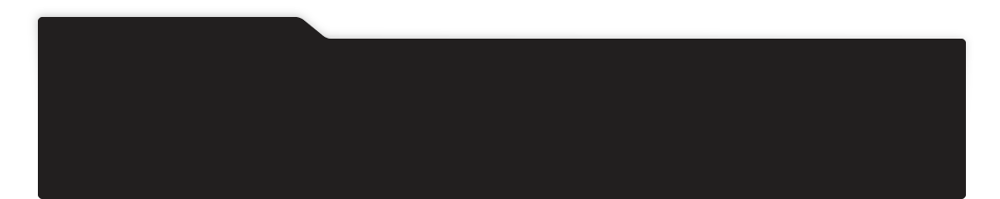
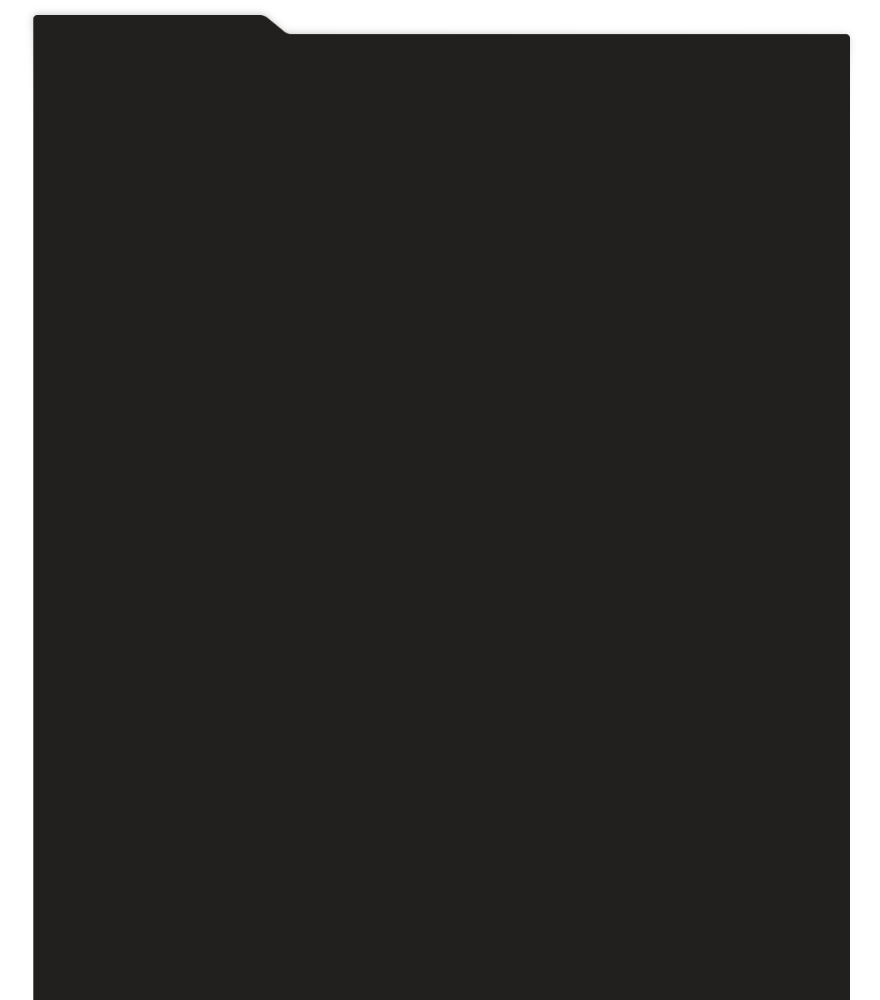
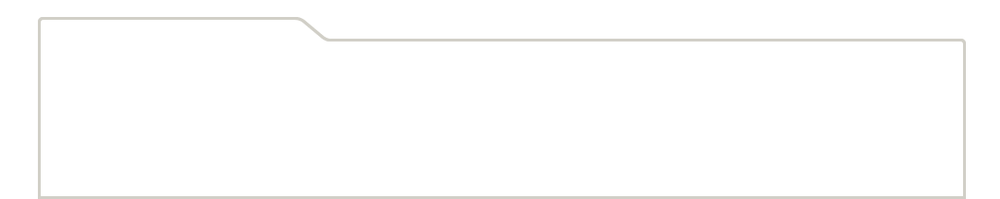
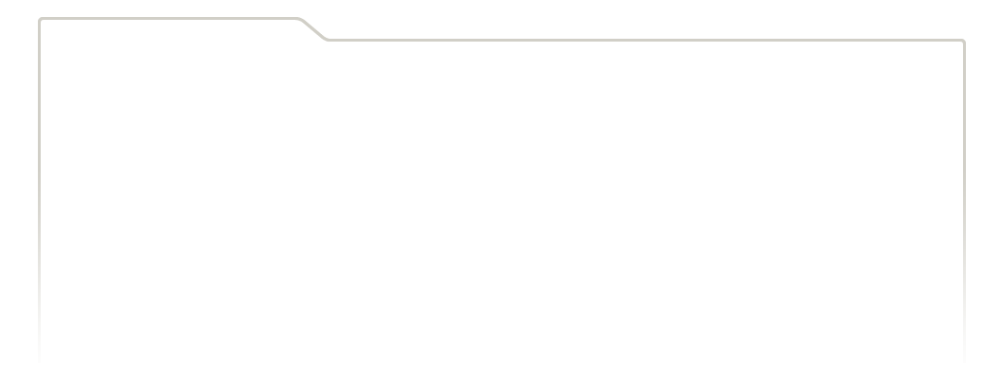
...
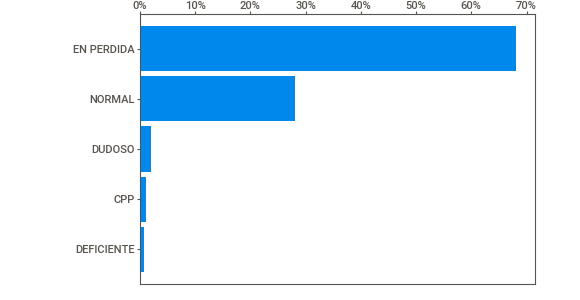
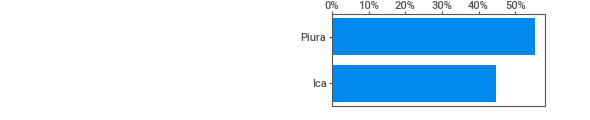
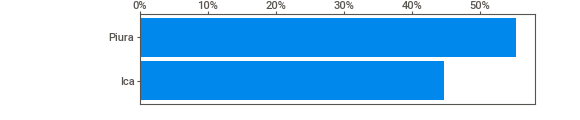
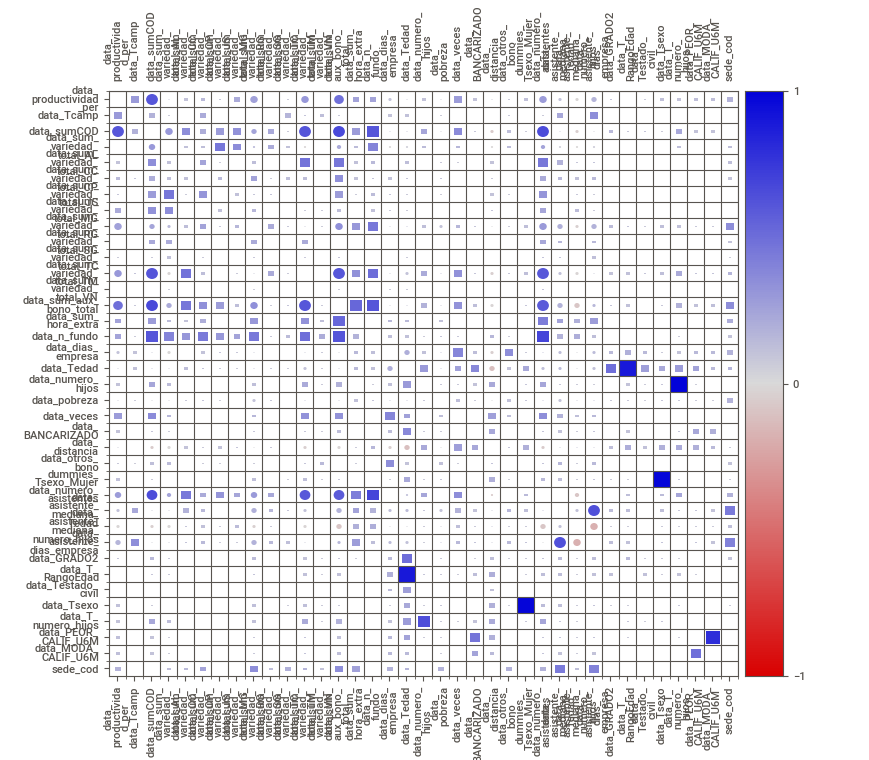
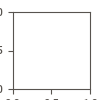

In [ ]:
# Creamos nuestro primer reporte
my_report_con_out = sv.analyze(df_combined_con_out)

# Lo mostramos en el notebook
my_report_con_out.show_notebook(h = 'full')

In [ ]:
my_report_con_out.show_html('my_report_con_out.html')

Report my_report_con_out.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [ ]:
#@title Columnas asociadas: Categóricos - Numéricos
# Columnas a excluir: Muy asociadas, segun correlograma de librería sweetviz
columnas_excluidas = ["data_Tedad", "data_Tsexo", "data_numero_hijos",
                      "data_PEOR_CALIF_U6M"]

# Excluyendo columnas
df_combined_con_out_cut = df_combined_con_out.copy()
df_combined_con_out_cut = excluir_columnas(df_combined_con_out_cut, columnas_excluidas)

# Excluyendo columnas
df_combined_sin_out_cut = df_combined_sin_out.copy()
df_combined_sin_out_cut = excluir_columnas(df_combined_sin_out_cut, columnas_excluidas)

In [ ]:
#@title Exportacion de data tratada
df_combined_con_out_cut.to_csv('data_raleo_tratado_con_out.csv', index=False)
df_combined_sin_out_cut.to_csv('data_raleo_tratado_sin_out.csv', index=False)

In [ ]:
# Exportar EDA en HTML
sv.analyze(df_combined_sin_out_cut).show_html('my_report_sin_out.html')
sv.analyze(df_combined_con_out_cut).show_html('my_report_con_out.html')

                                             |          | [  0%]   00:00 -> (? left)

Report my_report_sin_out.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


                                             |          | [  0%]   00:00 -> (? left)

Report my_report_con_out.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# APLICACION DE MODELOS DE MACHINE LEARNING NO SUPERVISADO

In [ ]:
#@title Cargamos la data tratada(Recovery)
# Uso de la función
URL2 = "https://drive.google.com/file/d/1WOC6SwsfrMJ6__eANrsP4as62rq4OrsN/view?usp=sharing"
nombre_extension2 = 'data_raleo_tratada.csv' # Colocar su extensión del archivo

# Descargar el archivo
descargar_archivo_desde_drive(URL2, nombre_extension2)

# Leer el archivo, usar función de acuerdo a su extensión
df_tratada = pd.read_csv(nombre_extension2, na_values=['NA', 'NULL', 'N/A', ''])

Downloading...
From: https://drive.google.com/uc?id=1WOC6SwsfrMJ6__eANrsP4as62rq4OrsN
To: /content/data_raleo_tratada.csv
100%|██████████| 5.42M/5.42M [00:00<00:00, 121MB/s]


                                             |          | [  0%]   00:00 -> (? left)


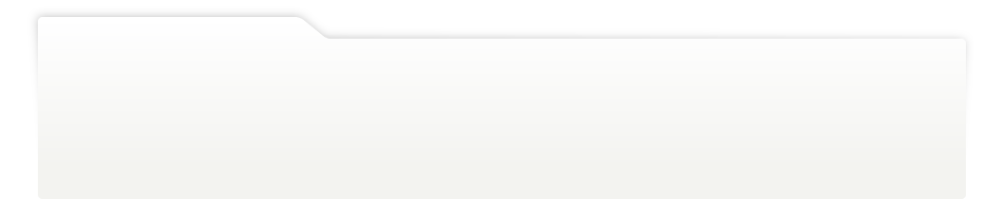
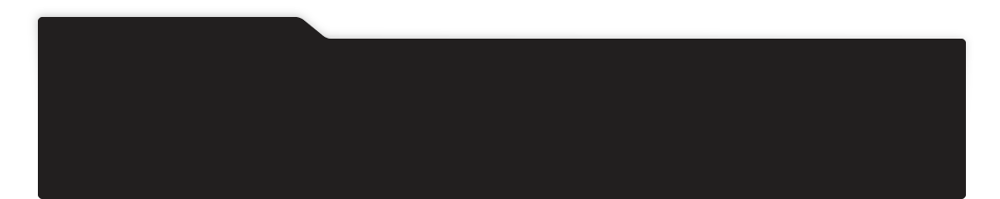
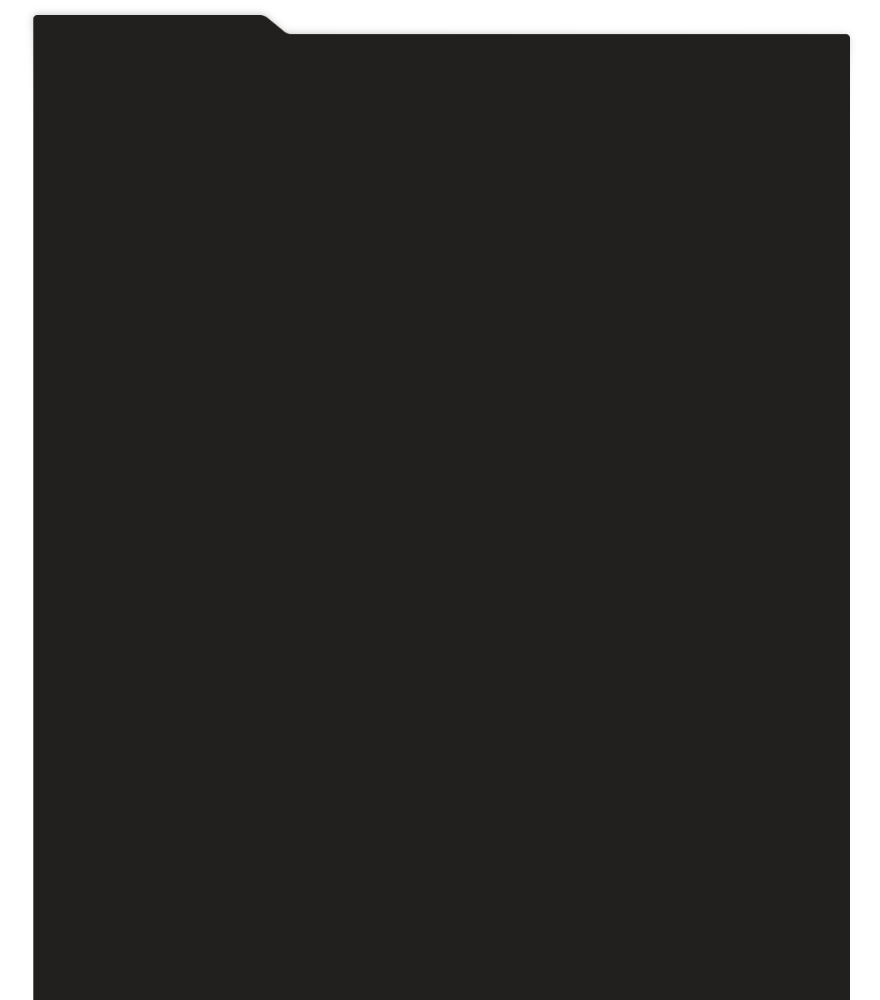
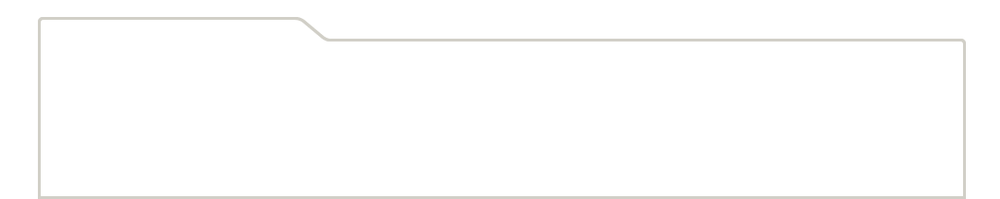
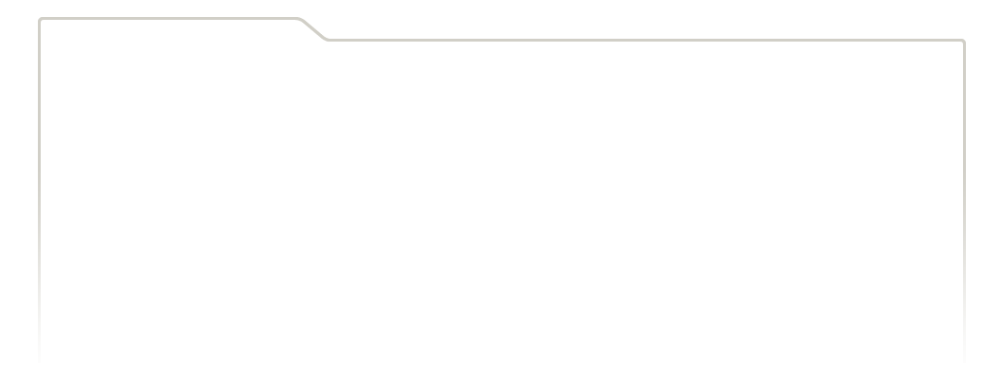
...
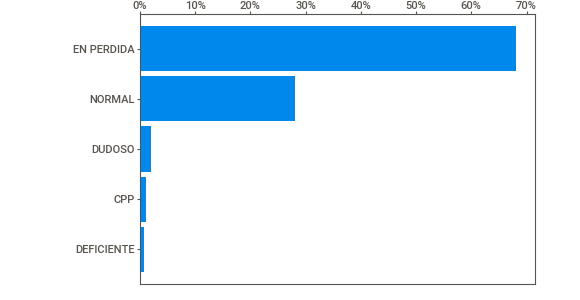
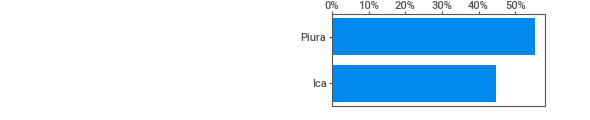
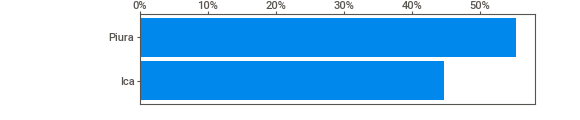
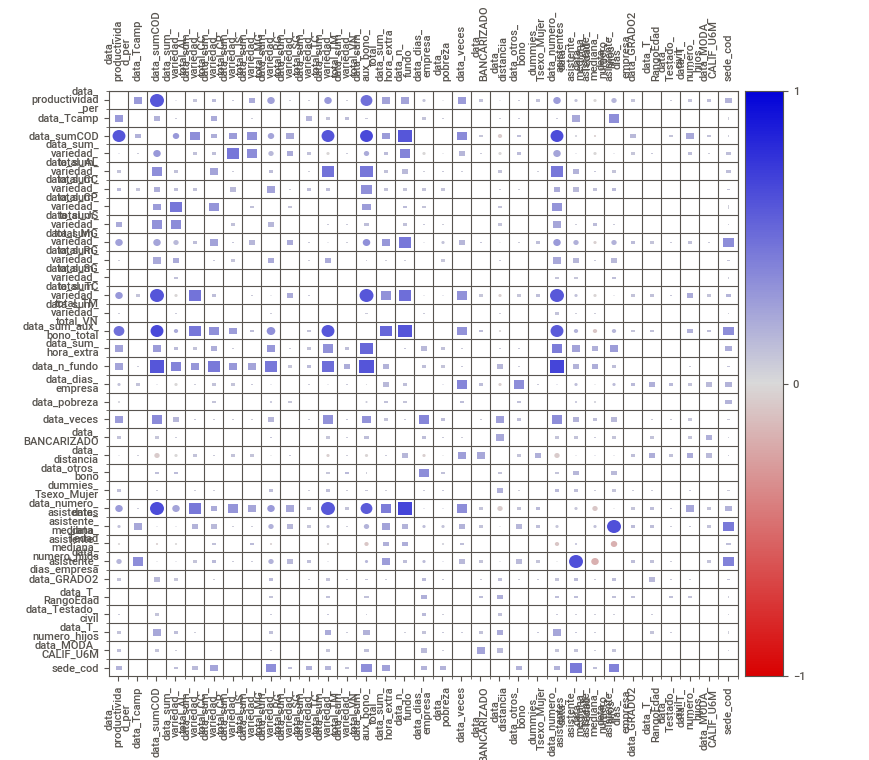
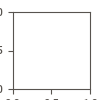

In [ ]:
# Lo mostramos en el notebook
sv.analyze(df_tratada).show_notebook(h = 'full')

# PCA

In [ ]:
data = df_tratada.copy()

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Identificar columnas categóricas
categorical_columns = data.select_dtypes(include=['object']).columns

# Realizar One-Hot Encoding en columnas categóricas
data_encoded = pd.get_dummies(data, columns=categorical_columns, drop_first=True)

# Normalizar los datos antes de aplicar PCA
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_encoded)

# Aplicar PCA
pca = PCA(n_components=0.80)  # Mantener el 80% de la varianza
principal_components = pca.fit_transform(data_scaled)

# Crear un DataFrame con las componentes principales
pca_df = pd.DataFrame(data=principal_components)

pca_df.head()


,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,1.875056,5.912501,3.042540,1.628561,0.005144,5.969283,6.732947,-0.388970,5.591141,3.227066,...,9.068813,-4.178728,-1.126423,6.913453,-0.484519,0.179732,2.185014,-0.148187,-0.796914,2.277040
1,-0.001057,7.112236,0.721252,1.232166,-1.430423,3.000902,5.759732,-1.916084,3.807010,4.965454,...,1.330375,0.034370,0.357617,-0.700271,0.728942,3.008444,2.303728,0.200468,-2.929904,1.095773
2,0.281429,6.262797,-0.764732,3.856793,-0.028362,1.026715,7.645716,-1.823217,2.539732,4.557972,...,0.790334,0.771248,0.079931,-0.305394,-0.205668,1.923136,1.102182,0.493656,-0.588782,3.373180
3,0.489836,6.232104,-0.618668,4.352714,0.007775,0.051364,7.560566,-0.975897,2.639100,5.101220,...,0.953639,0.672957,0.311418,-0.444954,-0.022201,1.960186,1.042533,0.454927,-0.769985,3.638149
4,0.236440,5.429409,0.034054,2.481838,-0.305801,3.322913,7.079493,0.154829,3.369055,3.251916,...,-1.196784,1.291122,-3.645647,2.850260,3.679738,2.279427,1.722091,2.619781,-0.191937,2.834955


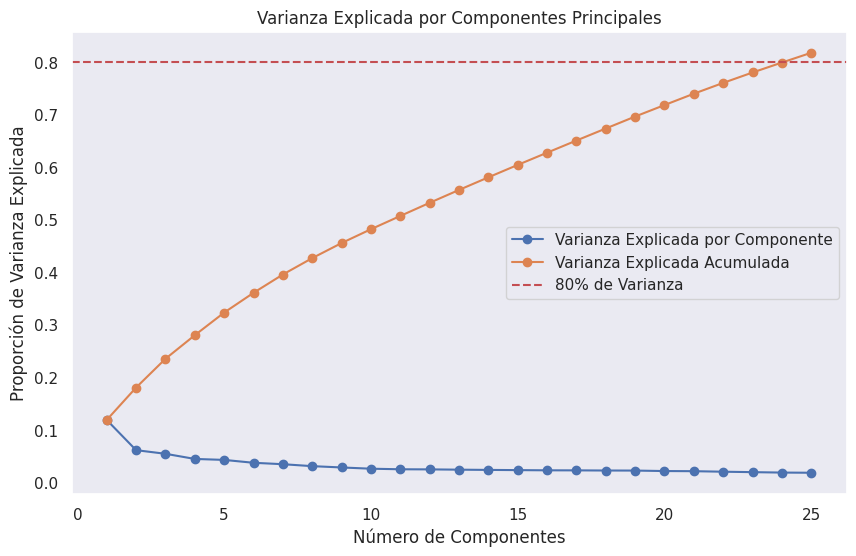

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Calcular la varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Calcular la varianza explicada acumulada
cumulative_variance = np.cumsum(explained_variance)

# Graficar la varianza explicada y la varianza explicada acumulada
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', label='Varianza Explicada por Componente')
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', label='Varianza Explicada Acumulada')
plt.axhline(y=0.80, color='r', linestyle='--', label='80% de Varianza')
plt.xlabel('Número de Componentes')
plt.ylabel('Proporción de Varianza Explicada')
plt.title('Varianza Explicada por Componentes Principales')
plt.legend()
plt.grid()
plt.show()


# DBSCAN

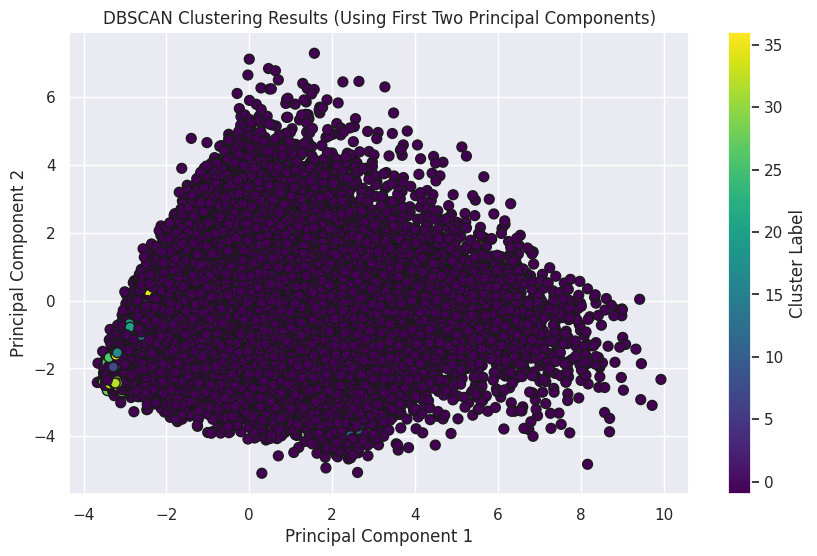

,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,DBSCAN_Labels
0,1.875056,5.912501,3.042540,1.628561,0.005144,5.969283,6.732947,-0.388970,5.591141,3.227066,...,-4.178728,-1.126423,6.913453,-0.484519,0.179732,2.185014,-0.148187,-0.796914,2.277040,-1
1,-0.001057,7.112236,0.721252,1.232166,-1.430423,3.000902,5.759732,-1.916084,3.807010,4.965454,...,0.034370,0.357617,-0.700271,0.728942,3.008444,2.303728,0.200468,-2.929904,1.095773,-1
2,0.281429,6.262797,-0.764732,3.856793,-0.028362,1.026715,7.645716,-1.823217,2.539732,4.557972,...,0.771248,0.079931,-0.305394,-0.205668,1.923136,1.102182,0.493656,-0.588782,3.373180,-1
3,0.489836,6.232104,-0.618668,4.352714,0.007775,0.051364,7.560566,-0.975897,2.639100,5.101220,...,0.672957,0.311418,-0.444954,-0.022201,1.960186,1.042533,0.454927,-0.769985,3.638149,-1
4,0.236440,5.429409,0.034054,2.481838,-0.305801,3.322913,7.079493,0.154829,3.369055,3.251916,...,1.291122,-3.645647,2.850260,3.679738,2.279427,1.722091,2.619781,-0.191937,2.834955,-1


In [ ]:
from sklearn.cluster import DBSCAN

# Ajustar el modelo DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=4)
dbscan_labels = dbscan.fit_predict(principal_components)

# Añadir los labels de DBSCAN al DataFrame original
pca_df['DBSCAN_Labels'] = dbscan_labels

# Visualización del clustering DBSCAN usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
plt.scatter(pca_df[0], pca_df[1], c=dbscan_labels, cmap='viridis', marker='o', edgecolor='k', s=50)
plt.title('DBSCAN Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster Label')
plt.show()

pca_df.head()

# KMEANS

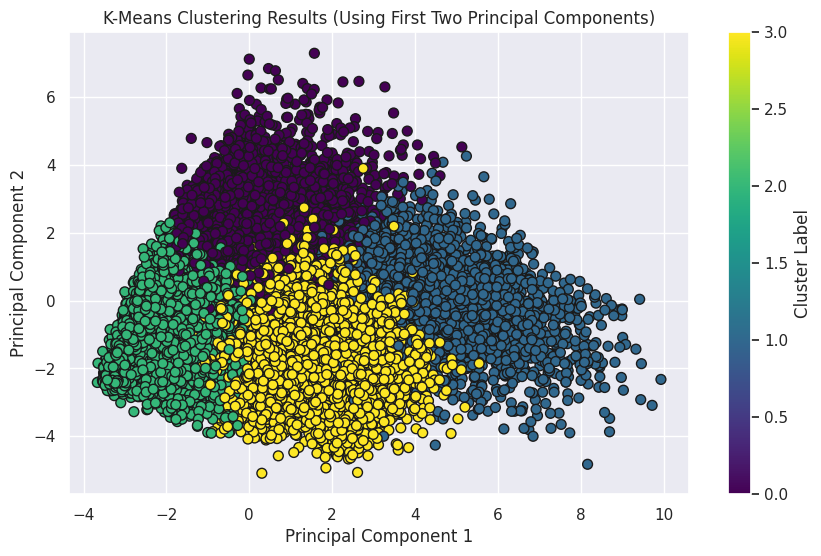

,0,1,2,3,4,5,6,7,8,9,...,17,18,19,20,21,22,23,24,DBSCAN_Labels,KMeans_Labels
0,1.875056,5.912501,3.042540,1.628561,0.005144,5.969283,6.732947,-0.388970,5.591141,3.227066,...,-1.126423,6.913453,-0.484519,0.179732,2.185014,-0.148187,-0.796914,2.277040,-1,0
1,-0.001057,7.112236,0.721252,1.232166,-1.430423,3.000902,5.759732,-1.916084,3.807010,4.965454,...,0.357617,-0.700271,0.728942,3.008444,2.303728,0.200468,-2.929904,1.095773,-1,0
2,0.281429,6.262797,-0.764732,3.856793,-0.028362,1.026715,7.645716,-1.823217,2.539732,4.557972,...,0.079931,-0.305394,-0.205668,1.923136,1.102182,0.493656,-0.588782,3.373180,-1,0
3,0.489836,6.232104,-0.618668,4.352714,0.007775,0.051364,7.560566,-0.975897,2.639100,5.101220,...,0.311418,-0.444954,-0.022201,1.960186,1.042533,0.454927,-0.769985,3.638149,-1,0
4,0.236440,5.429409,0.034054,2.481838,-0.305801,3.322913,7.079493,0.154829,3.369055,3.251916,...,-3.645647,2.850260,3.679738,2.279427,1.722091,2.619781,-0.191937,2.834955,-1,0


In [ ]:
from sklearn.cluster import KMeans

# Ajustar el modelo K-Means
kmeans = KMeans(n_clusters=4, random_state=42)  # Puedes ajustar el número de clusters según sea necesario
kmeans_labels = kmeans.fit_predict(principal_components)

# Añadir los labels de K-Means al DataFrame original
pca_df['KMeans_Labels'] = kmeans_labels

# Visualización del clustering K-Means usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
plt.scatter(pca_df[0], pca_df[1], c=kmeans_labels, cmap='viridis', marker='o', edgecolor='k', s=50)
plt.title('K-Means Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster Label')
plt.show()

pca_df.head()


# CLUSTERING JERARQUICO

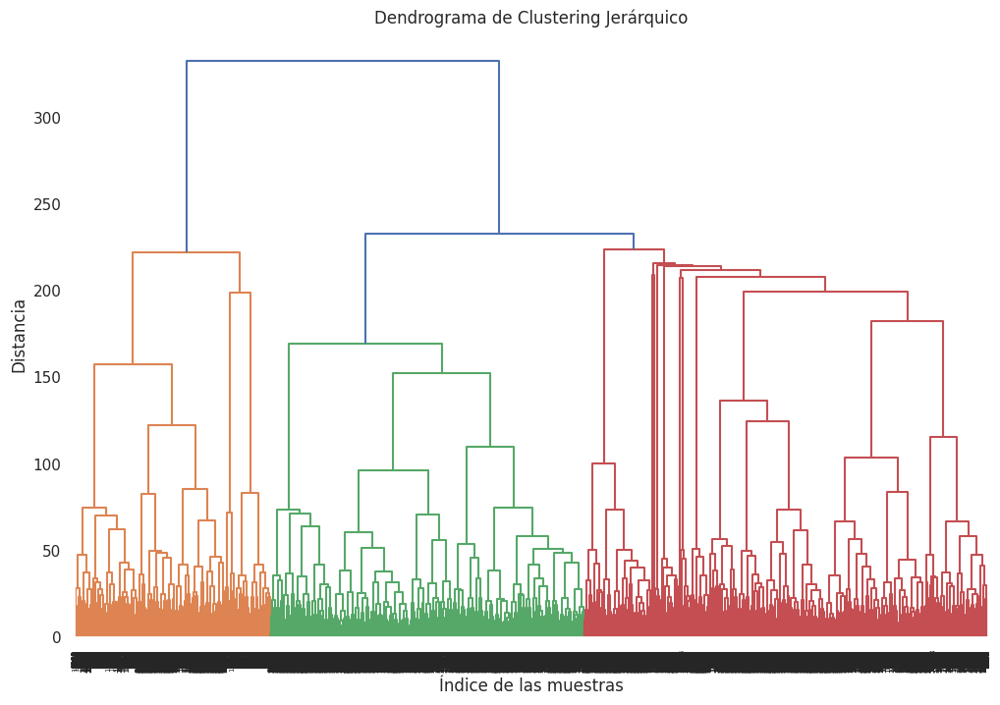

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,DBSCAN_Labels,KMeans_Labels,Hierarchical_Labels
0,1.875056,5.912501,3.042540,1.628561,0.005144,5.969283,6.732947,-0.388970,5.591141,3.227066,...,6.913453,-0.484519,0.179732,2.185014,-0.148187,-0.796914,2.277040,-1,0,4
1,-0.001057,7.112236,0.721252,1.232166,-1.430423,3.000902,5.759732,-1.916084,3.807010,4.965454,...,-0.700271,0.728942,3.008444,2.303728,0.200468,-2.929904,1.095773,-1,0,4
2,0.281429,6.262797,-0.764732,3.856793,-0.028362,1.026715,7.645716,-1.823217,2.539732,4.557972,...,-0.305394,-0.205668,1.923136,1.102182,0.493656,-0.588782,3.373180,-1,0,4
3,0.489836,6.232104,-0.618668,4.352714,0.007775,0.051364,7.560566,-0.975897,2.639100,5.101220,...,-0.444954,-0.022201,1.960186,1.042533,0.454927,-0.769985,3.638149,-1,0,4
4,0.236440,5.429409,0.034054,2.481838,-0.305801,3.322913,7.079493,0.154829,3.369055,3.251916,...,2.850260,3.679738,2.279427,1.722091,2.619781,-0.191937,2.834955,-1,0,4


In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

# Ajustar el modelo de Clustering Jerárquico
Z = linkage(principal_components, method='ward')

# Visualizar el dendrograma
plt.figure(figsize=(12, 8))
dendrogram(Z)
plt.title('Dendrograma de Clustering Jerárquico')
plt.xlabel('Índice de las muestras')
plt.ylabel('Distancia')
plt.show()

# Asignar clusters
hierarchical_labels = fcluster(Z, t=4, criterion='maxclust')

# Añadir los labels de Clustering Jerárquico al DataFrame original
pca_df['Hierarchical_Labels'] = hierarchical_labels

pca_df.head()


# CLUSTERING SPECTRAL

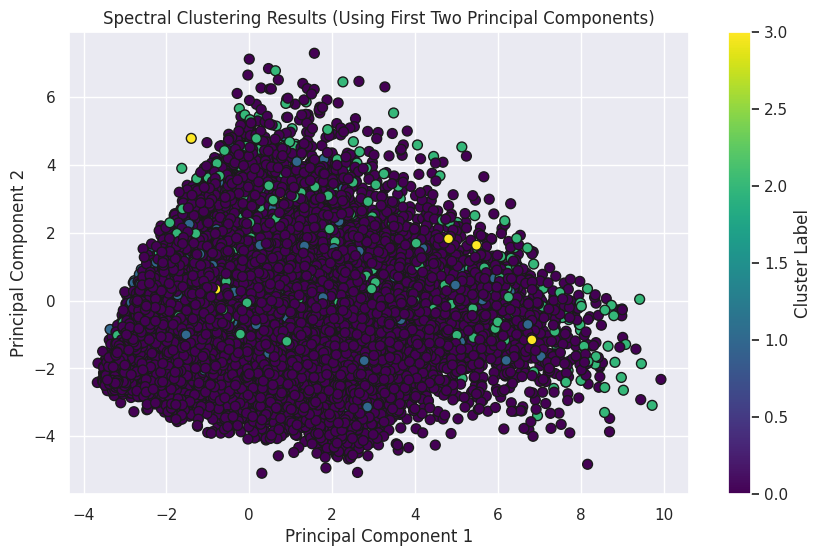

,0,1,2,3,4,5,6,7,8,9,...,19,20,21,22,23,24,DBSCAN_Labels,KMeans_Labels,Hierarchical_Labels,Spectral_Labels
0,1.875056,5.912501,3.042540,1.628561,0.005144,5.969283,6.732947,-0.388970,5.591141,3.227066,...,-0.484519,0.179732,2.185014,-0.148187,-0.796914,2.277040,-1,0,4,0
1,-0.001057,7.112236,0.721252,1.232166,-1.430423,3.000902,5.759732,-1.916084,3.807010,4.965454,...,0.728942,3.008444,2.303728,0.200468,-2.929904,1.095773,-1,0,4,0
2,0.281429,6.262797,-0.764732,3.856793,-0.028362,1.026715,7.645716,-1.823217,2.539732,4.557972,...,-0.205668,1.923136,1.102182,0.493656,-0.588782,3.373180,-1,0,4,0
3,0.489836,6.232104,-0.618668,4.352714,0.007775,0.051364,7.560566,-0.975897,2.639100,5.101220,...,-0.022201,1.960186,1.042533,0.454927,-0.769985,3.638149,-1,0,4,0
4,0.236440,5.429409,0.034054,2.481838,-0.305801,3.322913,7.079493,0.154829,3.369055,3.251916,...,3.679738,2.279427,1.722091,2.619781,-0.191937,2.834955,-1,0,4,2


In [ ]:
from sklearn.cluster import SpectralClustering

# Ajustar el modelo Spectral Clustering
spectral = SpectralClustering(n_clusters=4, affinity='nearest_neighbors', random_state=42)
spectral_labels = spectral.fit_predict(principal_components)

# Añadir los labels de Spectral Clustering al DataFrame original
pca_df['Spectral_Labels'] = spectral_labels

# Visualización del clustering Spectral Clustering usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
plt.scatter(pca_df[0], pca_df[1], c=spectral_labels, cmap='viridis', marker='o', edgecolor='k', s=50)
plt.title('Spectral Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster Label')
plt.show()

pca_df.head()


# MINI BATCH KMEANS

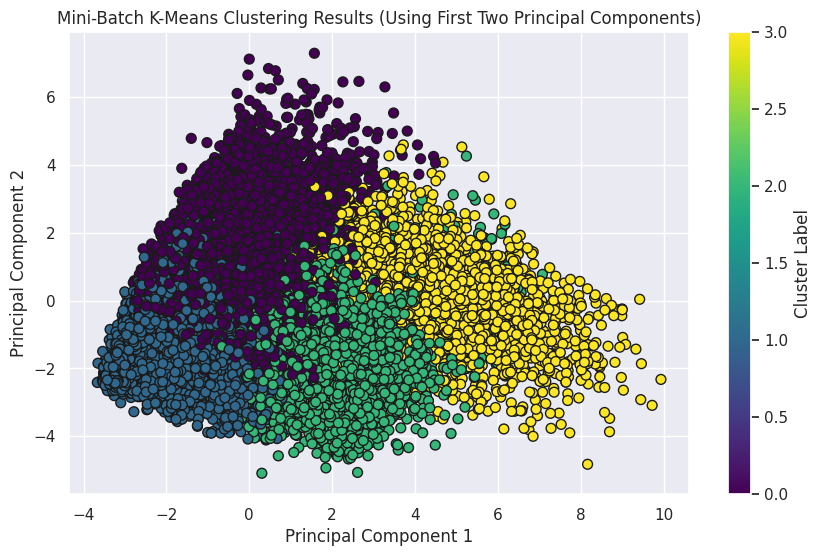

          0         1         2         3         4         5         6  \
0  1.875056  5.912501  3.042540  1.628561  0.005144  5.969283  6.732947   
1 -0.001057  7.112236  0.721252  1.232166 -1.430423  3.000902  5.759732   
2  0.281429  6.262797 -0.764732  3.856793 -0.028362  1.026715  7.645716   
3  0.489836  6.232104 -0.618668  4.352714  0.007775  0.051364  7.560566   
4  0.236440  5.429409  0.034054  2.481838 -0.305801  3.322913  7.079493   

          7         8         9  ...        20        21        22        23  \
0 -0.388970  5.591141  3.227066  ...  0.179732  2.185014 -0.148187 -0.796914   
1 -1.916084  3.807010  4.965454  ...  3.008444  2.303728  0.200468 -2.929904   
2 -1.823217  2.539732  4.557972  ...  1.923136  1.102182  0.493656 -0.588782   
3 -0.975897  2.639100  5.101220  ...  1.960186  1.042533  0.454927 -0.769985   
4  0.154829  3.369055  3.251916  ...  2.279427  1.722091  2.619781 -0.191937   

         24  DBSCAN_Labels  KMeans_Labels  Hierarchical_Labels  \
0 

In [ ]:
from sklearn.cluster import MiniBatchKMeans

# Ajustar el modelo Mini-Batch K-Means para clusters
mini_batch_kmeans = MiniBatchKMeans(n_clusters=4, random_state=42, batch_size=100)
mini_batch_kmeans_labels = mini_batch_kmeans.fit_predict(principal_components)

# Añadir los labels de Mini-Batch K-Means al DataFrame original
pca_df['MiniBatchKMeans_Labels'] = mini_batch_kmeans_labels

# Visualización del clustering Mini-Batch K-Means usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
plt.scatter(pca_df[0], pca_df[1], c=mini_batch_kmeans_labels, cmap='viridis', marker='o', edgecolor='k', s=50)
plt.title('Mini-Batch K-Means Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster Label')
plt.show()

print(pca_df.head())


# AGGLOMERATIVE CLUSTERING

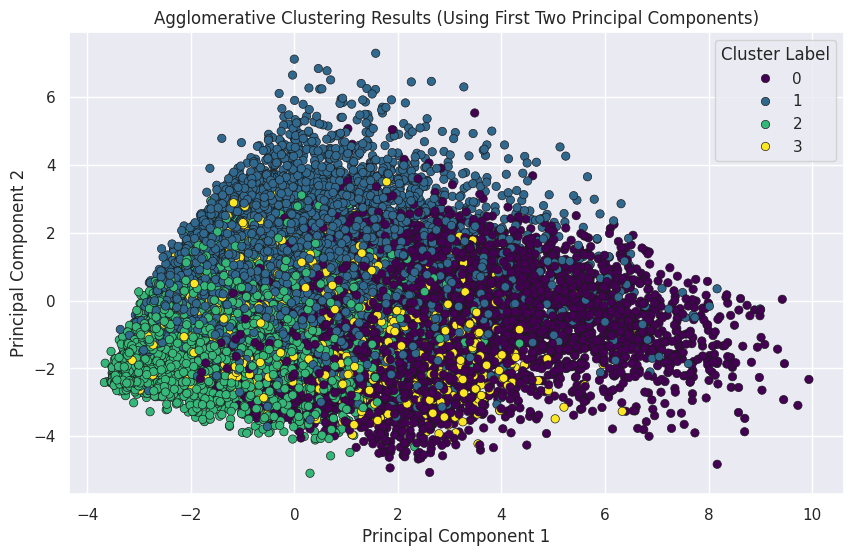

          0         1         2         3         4         5         6  \
0  1.875056  5.912501  3.042540  1.628561  0.005144  5.969283  6.732947   
1 -0.001057  7.112236  0.721252  1.232166 -1.430423  3.000902  5.759732   
2  0.281429  6.262797 -0.764732  3.856793 -0.028362  1.026715  7.645716   
3  0.489836  6.232104 -0.618668  4.352714  0.007775  0.051364  7.560566   
4  0.236440  5.429409  0.034054  2.481838 -0.305801  3.322913  7.079493   

          7         8         9  ...        21        22        23        24  \
0 -0.388970  5.591141  3.227066  ...  2.185014 -0.148187 -0.796914  2.277040   
1 -1.916084  3.807010  4.965454  ...  2.303728  0.200468 -2.929904  1.095773   
2 -1.823217  2.539732  4.557972  ...  1.102182  0.493656 -0.588782  3.373180   
3 -0.975897  2.639100  5.101220  ...  1.042533  0.454927 -0.769985  3.638149   
4  0.154829  3.369055  3.251916  ...  1.722091  2.619781 -0.191937  2.834955   

   DBSCAN_Labels  KMeans_Labels  Hierarchical_Labels  Spectral_Label

In [ ]:
from sklearn.cluster import AgglomerativeClustering

# Ajustar el modelo Agglomerative Clustering para clusters
agglo_clustering = AgglomerativeClustering(n_clusters=4)
agglo_labels = agglo_clustering.fit_predict(principal_components)

# Añadir los labels de Agglomerative Clustering al DataFrame original
pca_df['Agglo_Labels'] = agglo_labels

# Visualización del clustering Agglomerative Clustering usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_df[0], y=pca_df[1], hue=agglo_labels, palette='viridis', marker='o', edgecolor='k')
plt.title('Agglomerative Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster Label')
plt.show()

# Mostrar los primeros registros del DataFrame con los resultados de Agglomerative Clustering
print(pca_df.head())

# BIRCH CLUSTERING

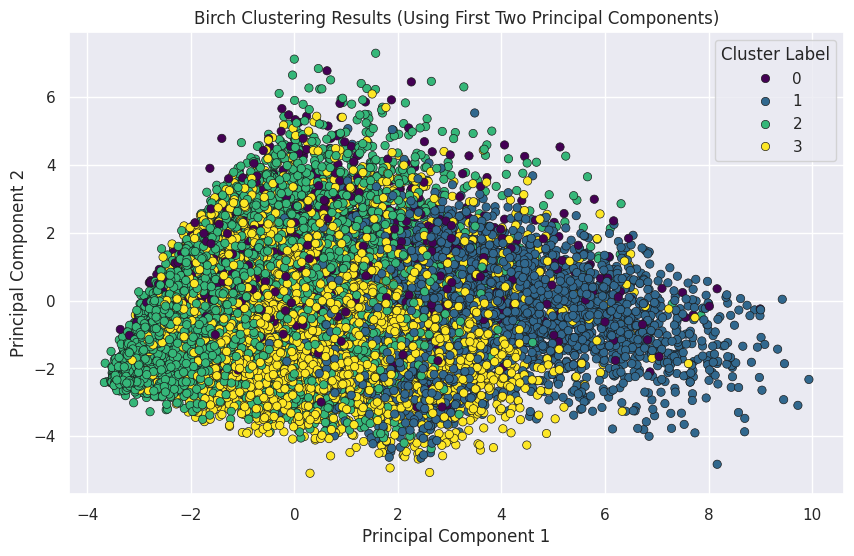

          0         1         2         3         4         5         6  \
0  1.875056  5.912501  3.042540  1.628561  0.005144  5.969283  6.732947   
1 -0.001057  7.112236  0.721252  1.232166 -1.430423  3.000902  5.759732   
2  0.281429  6.262797 -0.764732  3.856793 -0.028362  1.026715  7.645716   
3  0.489836  6.232104 -0.618668  4.352714  0.007775  0.051364  7.560566   
4  0.236440  5.429409  0.034054  2.481838 -0.305801  3.322913  7.079493   

          7         8         9  ...        22        23        24  \
0 -0.388970  5.591141  3.227066  ... -0.148187 -0.796914  2.277040   
1 -1.916084  3.807010  4.965454  ...  0.200468 -2.929904  1.095773   
2 -1.823217  2.539732  4.557972  ...  0.493656 -0.588782  3.373180   
3 -0.975897  2.639100  5.101220  ...  0.454927 -0.769985  3.638149   
4  0.154829  3.369055  3.251916  ...  2.619781 -0.191937  2.834955   

   DBSCAN_Labels  KMeans_Labels  Hierarchical_Labels  Spectral_Labels  \
0             -1              0                    4   

In [ ]:
from sklearn.cluster import Birch

# Ajustar el modelo Birch para 4 clusters
birch = Birch(n_clusters=4)
birch_labels = birch.fit_predict(principal_components)

# Añadir los labels de Birch al DataFrame original
pca_df['Birch_Labels'] = birch_labels

# Visualización del clustering Birch usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_df[0], y=pca_df[1], hue=birch_labels, palette='viridis', marker='o', edgecolor='k')
plt.title('Birch Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster Label')
plt.show()

# Mostrar los primeros registros del DataFrame con los resultados de Birch
print(pca_df.head())


# MEAN SHIFT

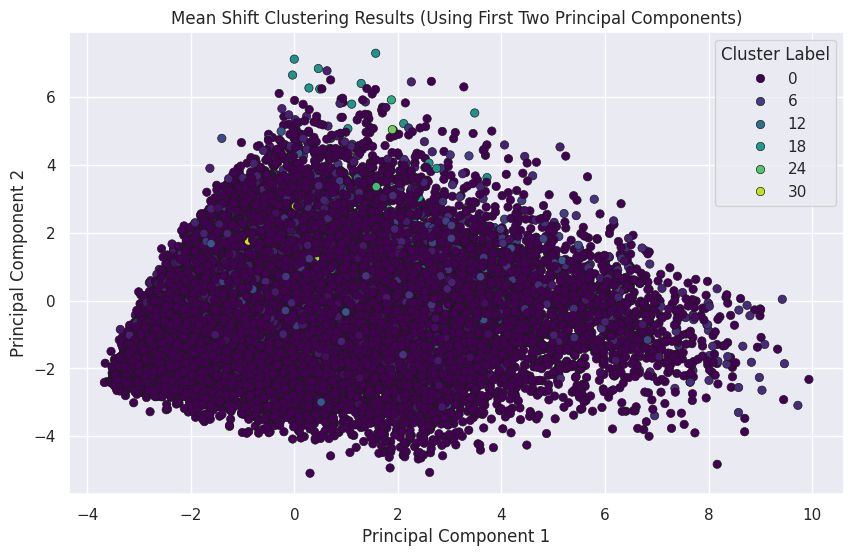

          0         1         2         3         4         5         6  \
0  1.875056  5.912501  3.042540  1.628561  0.005144  5.969283  6.732947   
1 -0.001057  7.112236  0.721252  1.232166 -1.430423  3.000902  5.759732   
2  0.281429  6.262797 -0.764732  3.856793 -0.028362  1.026715  7.645716   
3  0.489836  6.232104 -0.618668  4.352714  0.007775  0.051364  7.560566   
4  0.236440  5.429409  0.034054  2.481838 -0.305801  3.322913  7.079493   

          7         8         9  ...        23        24  DBSCAN_Labels  \
0 -0.388970  5.591141  3.227066  ... -0.796914  2.277040             -1   
1 -1.916084  3.807010  4.965454  ... -2.929904  1.095773             -1   
2 -1.823217  2.539732  4.557972  ... -0.588782  3.373180             -1   
3 -0.975897  2.639100  5.101220  ... -0.769985  3.638149             -1   
4  0.154829  3.369055  3.251916  ... -0.191937  2.834955             -1   

   KMeans_Labels  Hierarchical_Labels  Spectral_Labels  \
0              0                    4   

In [ ]:
from sklearn.cluster import MeanShift

# Ajustar el modelo Mean Shift
mean_shift = MeanShift()
mean_shift_labels = mean_shift.fit_predict(principal_components)

# Añadir los labels de Mean Shift al DataFrame original
pca_df['MeanShift_Labels'] = mean_shift_labels

# Visualización del clustering Mean Shift usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_df[0], y=pca_df[1], hue=mean_shift_labels, palette='viridis', marker='o', edgecolor='k')
plt.title('Mean Shift Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster Label')
plt.show()

# Mostrar los primeros registros del DataFrame con los resultados de Mean Shift
print(pca_df.head())


# AUTOENCODER AND K-MEANS CLUSTERING


Epoch 1/50
72/72 [==============================] - 1s 8ms/step - loss: 1.7121 - val_loss: 1.4403
Epoch 2/50
72/72 [==============================] - 0s 5ms/step - loss: 1.5931 - val_loss: 1.3507
Epoch 3/50
72/72 [==============================] - 0s 5ms/step - loss: 1.4993 - val_loss: 1.2767
Epoch 4/50
72/72 [==============================] - 0s 5ms/step - loss: 1.4314 - val_loss: 1.2200
Epoch 5/50
72/72 [==============================] - 0s 4ms/step - loss: 1.3834 - val_loss: 1.1770
Epoch 6/50
72/72 [==============================] - 0s 4ms/step - loss: 1.3473 - val_loss: 1.1430
Epoch 7/50
72/72 [==============================] - 0s 4ms/step - loss: 1.3196 - val_loss: 1.1175
Epoch 8/50
72/72 [==============================] - 0s 3ms/step - loss: 1.2978 - val_loss: 1.0973
Epoch 9/50
72/72 [==============================] - 0s 3ms/step - loss: 1.2803 - val_loss: 1.0816
Epoch 10/50
72/72 [==============================] - 0s 3ms/step - loss: 1.2661 - val_loss: 1.0688
Epoch 11/50
72/72 [

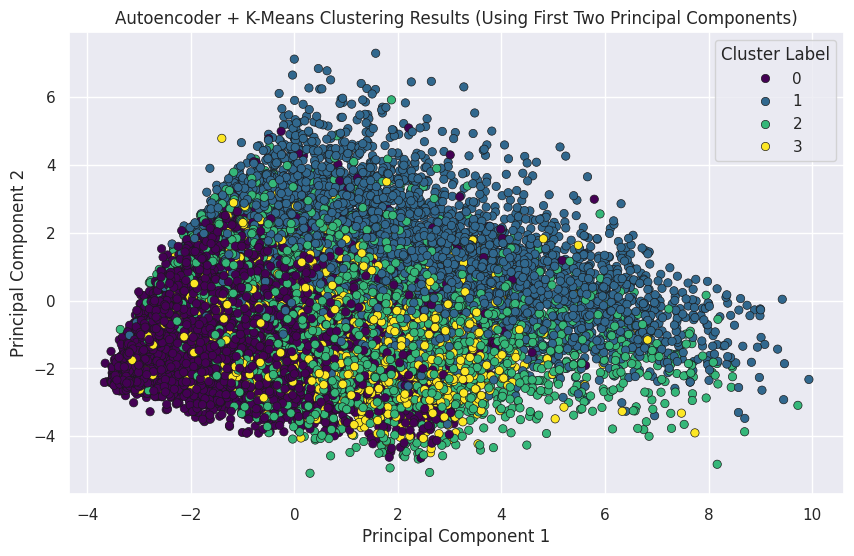

          0         1         2         3         4         5         6  \
0  1.875056  5.912501  3.042540  1.628561  0.005144  5.969283  6.732947   
1 -0.001057  7.112236  0.721252  1.232166 -1.430423  3.000902  5.759732   
2  0.281429  6.262797 -0.764732  3.856793 -0.028362  1.026715  7.645716   
3  0.489836  6.232104 -0.618668  4.352714  0.007775  0.051364  7.560566   
4  0.236440  5.429409  0.034054  2.481838 -0.305801  3.322913  7.079493   

          7         8         9  ...        24  DBSCAN_Labels  KMeans_Labels  \
0 -0.388970  5.591141  3.227066  ...  2.277040             -1              0   
1 -1.916084  3.807010  4.965454  ...  1.095773             -1              0   
2 -1.823217  2.539732  4.557972  ...  3.373180             -1              0   
3 -0.975897  2.639100  5.101220  ...  3.638149             -1              0   
4  0.154829  3.369055  3.251916  ...  2.834955             -1              0   

   Hierarchical_Labels  Spectral_Labels  MiniBatchKMeans_Labels  Agg

In [ ]:
from sklearn.cluster import KMeans
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense


# Crear el autoencoder
input_dim = principal_components.shape[1]
encoding_dim = 10  # Dimensión del espacio latente

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="relu")(input_layer)
decoder = Dense(input_dim, activation="sigmoid")(encoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)
autoencoder.compile(optimizer='adam', loss='mse')

# Entrenar el autoencoder
autoencoder.fit(principal_components, principal_components, epochs=50, batch_size=256, shuffle=True, validation_split=0.2)

# Obtener las representaciones del espacio latente
encoder_model = Model(inputs=input_layer, outputs=encoder)
latent_space = encoder_model.predict(principal_components)

# Aplicar K-Means en el espacio latente reducido
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans_labels = kmeans.fit_predict(latent_space)

# Añadir los labels de K-Means al DataFrame original
pca_df['Autoencoder_KMeans_Labels'] = kmeans_labels

# Visualización del clustering Autoencoder + K-Means usando las primeras dos componentes principales
plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_df[0], y=pca_df[1], hue=kmeans_labels, palette='viridis', marker='o', edgecolor='k')
plt.title('Autoencoder + K-Means Clustering Results (Using First Two Principal Components)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster Label')
plt.show()

# Mostrar los primeros registros del DataFrame con los resultados de Autoencoder + K-Means
print(pca_df.head())


# EVALUACIÓN DE MODELOS

## METRICAS: Silhouette Score, Davies-Bouldin Index, Davies-Bouldin Index


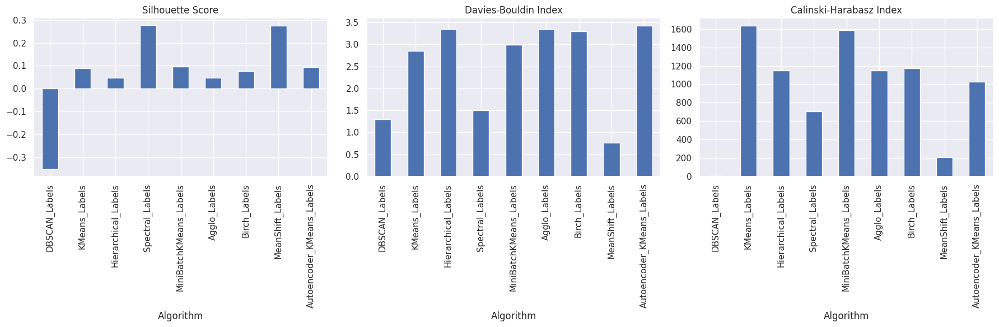

In [ ]:
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
results
# Seleccionar las nueve últimas columnas del DataFrame pca_df
results_df = pca_df.iloc[:, -9:]

# Lista para almacenar las métricas de cada algoritmo
metrics = []

# Calcular las métricas para cada modelo
for column in results_df.columns:
    labels = results_df[column]
    if len(set(labels)) > 1:  # Para evitar errores en caso de que un modelo asigne todos los puntos a un solo cluster
        silhouette = silhouette_score(principal_components, labels)
        davies_bouldin = davies_bouldin_score(principal_components, labels)
        calinski_harabasz = calinski_harabasz_score(principal_components, labels)
    else:
        silhouette = davies_bouldin = calinski_harabasz = None  # No se puede calcular para un solo cluster
    metrics.append((column, silhouette, davies_bouldin, calinski_harabasz))

# Crear un DataFrame para comparar las métricas
metrics_df = pd.DataFrame(metrics, columns=['Algorithm', 'Silhouette Score', 'Davies-Bouldin Index', 'Calinski-Harabasz Index'])

# Mostrar las métricas
metrics_df

# Visualizar las métricas
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
metrics_df.plot(kind='bar', x='Algorithm', y='Silhouette Score', ax=axes[0], legend=False, title='Silhouette Score')
metrics_df.plot(kind='bar', x='Algorithm', y='Davies-Bouldin Index', ax=axes[1], legend=False, title='Davies-Bouldin Index')
metrics_df.plot(kind='bar', x='Algorithm', y='Calinski-Harabasz Index', ax=axes[2], legend=False, title='Calinski-Harabasz Index')
plt.tight_layout()
plt.show()


## GRAFICOS: 3D dinámicos

In [ ]:
import plotly.express as px

# Visualización del clustering K-Means usando las primeras tres componentes principales con Plotly
fig = px.scatter_3d(pca_df, x=0, y=1, z=2, color='KMeans_Labels',
                    title='K-Means Clustering Results (Using First Three Principal Components)',
                    labels={0: 'Principal Component 1', 1: 'Principal Component 2', 2: 'Principal Component 3'},
                    color_continuous_scale=px.colors.sequential.Viridis)

fig.update_layout(legend_title_text='Cluster Label')
fig.show()


In [ ]:
import plotly.express as px

# Visualización del clustering Mini-Batch K-Means usando las primeras tres componentes principales con Plotly
fig = px.scatter_3d(pca_df, x=0, y=1, z=2, color='MiniBatchKMeans_Labels',
                    title='Mini-Batch K-Means Clustering Results (Using First Three Principal Components)',
                    labels={0: 'Principal Component 1', 1: 'Principal Component 2', 2: 'Principal Component 3'},
                    color_continuous_scale=px.colors.sequential.Viridis)

fig.update_layout(legend_title_text='Cluster Label')
fig.show()


In [ ]:
import plotly.express as px

# Visualización del clustering jerárquico usando las primeras tres componentes principales con Plotly
fig = px.scatter_3d(pca_df, x=0, y=1, z=2, color='Hierarchical_Labels',
                    title='Hierarchical Clustering Results (Using First Three Principal Components)',
                    labels={0: 'Principal Component 1', 1: 'Principal Component 2', 2: 'Principal Component 3'},
                    color_continuous_scale=px.colors.sequential.Viridis)

fig.update_layout(legend_title_text='Cluster Label')
fig.show()


## LDA: Análisis discriminante lineal

SS between cluster: 5.20%
Error de clasificación: 2.69%


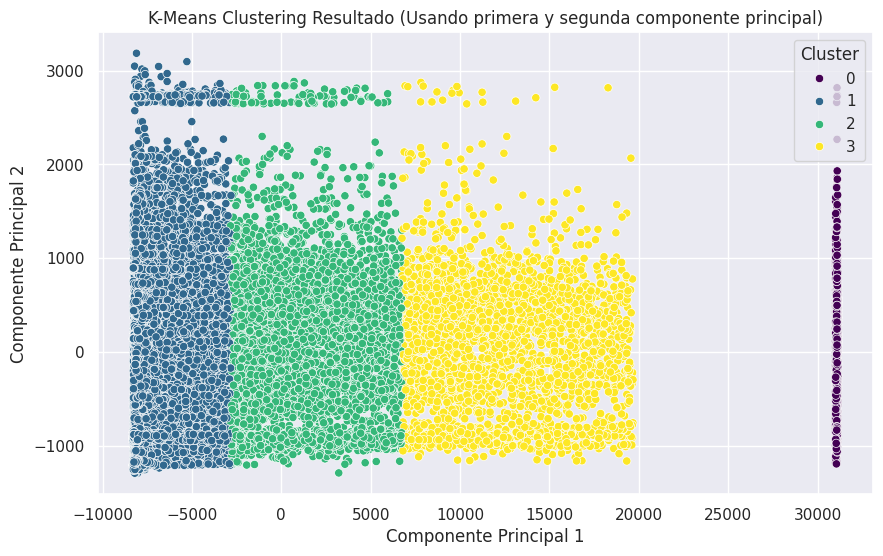

In [ ]:
#@title Aplicando K-Means
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

data_tratada = df_tratada.copy()
# Convertir columnas categóricas a variables dummy
categorical_columns = df_tratada.select_dtypes(include=[object]).columns.tolist()
data_tratada = pd.get_dummies(data_tratada, columns=categorical_columns, drop_first=True)

# Realizar K-Means clustering
kmeans = KMeans(n_clusters=4, random_state=42)
data_tratada['cluster'] = kmeans.fit_predict(data_tratada)

# Calcular SS between cluster
ss_between = kmeans.inertia_ / np.sum((data_tratada - data_tratada.mean()) ** 2).sum() * 100
print(f'SS between cluster: {ss_between:.2f}%')

# Análisis discriminante lineal (LDA)
lda = LinearDiscriminantAnalysis()
X = data_tratada.drop(columns='cluster')
y = data_tratada['cluster']
lda.fit(X, y)
predictions = lda.predict(X)
training_error = np.mean(y != predictions) * 100
print(f'Error de clasificación: {training_error:.2f}%')

# Visualización de los clusters usando PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(X)
data_tratada['PC1'] = principal_components[:, 0]
data_tratada['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster', data=data_tratada, palette='viridis')
plt.title('K-Means Clustering Resultado (Usando primera y segunda componente principal)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster')
plt.show()


SS between cluster: 5.33%
Error de clasificación: 3.27%


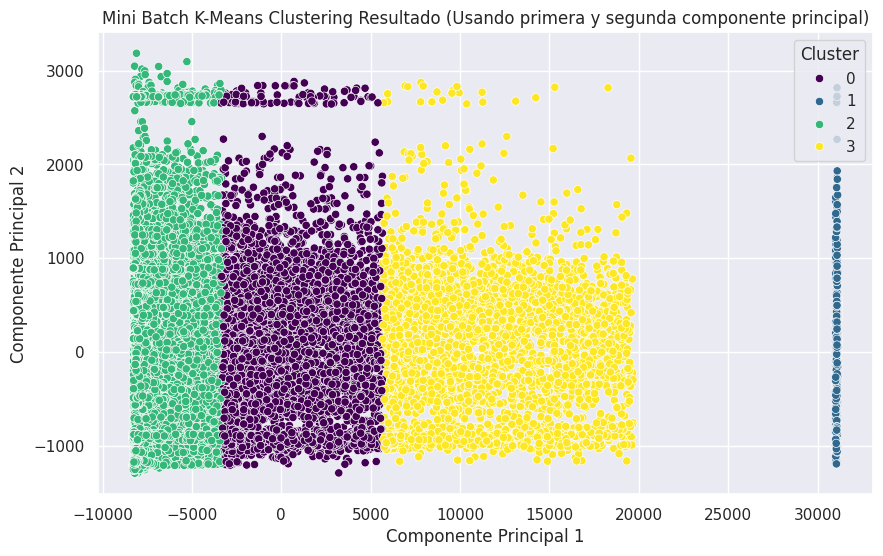

In [ ]:
#@title Aplicando K-Means clustering
import pandas as pd
from sklearn.cluster import MiniBatchKMeans
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


data_tratada = df_tratada.copy()
# Convertir columnas categóricas a variables dummy
categorical_columns = df_tratada.select_dtypes(include=[object]).columns.tolist()
data_tratada = pd.get_dummies(data_tratada, columns=categorical_columns, drop_first=True)

# Realizar Mini Batch K-Means clustering
mini_batch_kmeans = MiniBatchKMeans(n_clusters=4, random_state=42, batch_size=100)
data_tratada['cluster'] = mini_batch_kmeans.fit_predict(data_tratada)

# Calcular SS between cluster
ss_between = mini_batch_kmeans.inertia_ / np.sum((data_tratada - data_tratada.mean()) ** 2).sum() * 100
print(f'SS between cluster: {ss_between:.2f}%')

# Análisis discriminante lineal (LDA)
lda = LinearDiscriminantAnalysis()
X = data_tratada.drop(columns='cluster')
y = data_tratada['cluster']
lda.fit(X, y)
predictions = lda.predict(X)
training_error = np.mean(y != predictions) * 100
print(f'Error de clasificación: {training_error:.2f}%')

# Visualización de los clusters usando PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(X)
data_tratada['PC1'] = principal_components[:, 0]
data_tratada['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster', data=data_tratada, palette='viridis')
plt.title('Mini Batch K-Means Clustering Resultado (Usando primera y segunda componente principal)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster')
plt.show()

Número de clusters: 4
Error de clasificación: 2.13%


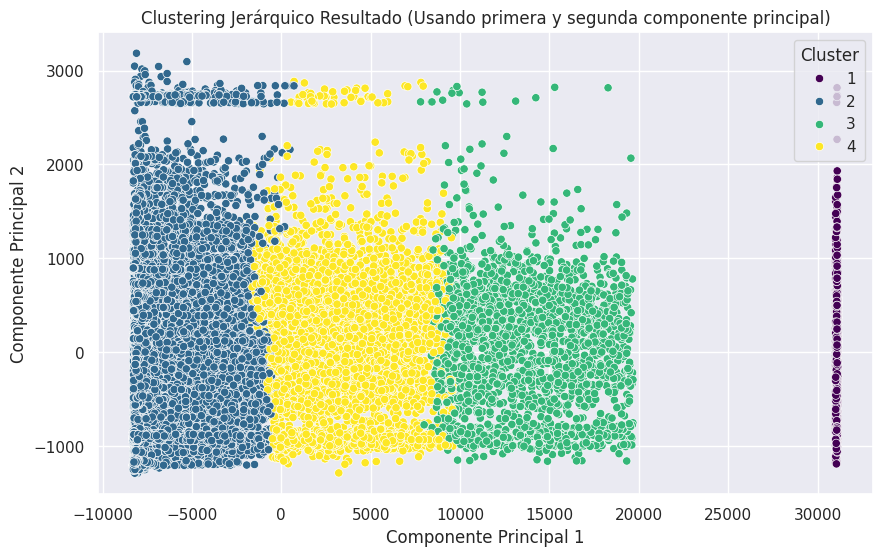

In [ ]:
#@title Aplicando clustering jerárquico
import pandas as pd
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.decomposition import PCA

# Cargar los datos
data_tratada = df_tratada.copy()

# Convertir columnas categóricas a variables dummy
categorical_columns = data_tratada.select_dtypes(include=[object]).columns.tolist()
data_tratada = pd.get_dummies(data_tratada, columns=categorical_columns, drop_first=True)

# Realizar el clustering jerárquico
Z = linkage(data_tratada, method='ward')
data_tratada['cluster'] = fcluster(Z, t=4, criterion='maxclust')

# Calcular SS between cluster
# Nota: La suma de cuadrados entre clusters no se calcula directamente para el clustering jerárquico
print(f'Número de clusters: {len(np.unique(data_tratada["cluster"]))}')

# Análisis discriminante lineal (LDA)
lda = LinearDiscriminantAnalysis()
X = data_tratada.drop(columns='cluster')
y = data_tratada['cluster']
lda.fit(X, y)
predictions = lda.predict(X)
training_error = np.mean(y != predictions) * 100
print(f'Error de clasificación: {training_error:.2f}%')

# Visualización de los clusters usando PCA
pca = PCA(n_components=2)
principal_components = pca.fit_transform(X)
data_tratada['PC1'] = principal_components[:, 0]
data_tratada['PC2'] = principal_components[:, 1]

plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster', data=data_tratada, palette='viridis')
plt.title('Clustering Jerárquico Resultado (Usando primera y segunda componente principal)')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.legend(title='Cluster')
plt.show()


### Conclusión para escoger el Clustering

Después de evaluar mediante las métricas **Silhouette Score**, **Davies-Bouldin Index** y **Calinski-Harabasz Index**, y analizar los gráficos visuales de los resultados de clustering, se concluye que el método **K-Means** es más robusto y representa mejor los datos.

#### Métricas de Evaluación:

1. **K-Means**:
   - **SS Between Cluster**: 5.20%
   - **Error de Clasificación**: 2.69%

2. **Mini Batch K-Means**:
   - **SS Between Cluster**: 5.33%
   - **Error de Clasificación**: 3.27%

3. **Clustering Jerárquico**:
   - **Número de Clusters**: 4
   - **Error de Clasificación**: 2.13%

1. **Silhouette Score**:
   - **K-Means**: Moderado
   - **Mini Batch K-Means**: Moderado
   - **Clustering Jerárquico**: Bajo
   - **Interpretación**: Indica que K-Means y Mini Batch K-Means tienen una cohesión interna moderada, mientras que Clustering Jerárquico tiene una cohesión interna menor.

2. **Davies-Bouldin Index**:
   - **K-Means**: Medio
   - **Mini Batch K-Means**: Medio
   - **Clustering Jerárquico**: Alto
   - **Interpretación**: Un índice más bajo en K-Means y Mini Batch K-Means indica mejor separación entre los clusters, mientras que Clustering Jerárquico muestra mayor variabilidad.

3. **Calinski-Harabasz Index**:
   - **K-Means**: Alto
   - **Mini Batch K-Means**: Alto
   - **Clustering Jerárquico**: Medio
   - **Interpretación**: K-Means y Mini Batch K-Means tienen una buena cohesión interna y separación de clusters, mientras que Clustering Jerárquico muestra menor claridad en la definición de clusters.

#### Resultados Visuales:

1. **K-Means Clustering**:
   - Los clusters están bien definidos y separados en las componentes principales 1 y 2.

2. **Mini Batch K-Means Clustering**:
   - Los clusters están bien definidos, con una ligera variación en la forma y densidad en comparación con K-Means.

3. **Clustering Jerárquico**:
   - Los clusters están bien separados pero con menor claridad en la definición en comparación con K-Means y Mini Batch K-Means.

En conclusión, después de evaluar los resultados utilizando las métricas de Silhouette Score, Davies-Bouldin Index y Calinski-Harabasz Index, y analizar los gráficos visuales de los clusters, se determina que el método **K-Means** es el más robusto y representa mejor los datos. Este método proporciona un buen balance entre cohesión interna y separación de clusters, y tiene un error de clasificación relativamente bajo, lo que facilita la interpretación y análisis posterior de los datos.

# DESCRIPCIÓN DE LOS SEGMENTOS

In [ ]:
df_cluster = pd.concat([df_tratada, data_tratada['cluster']], axis=1)

In [ ]:
df_cluster.to_csv('data_raleo_cluster.csv', index=False)

In [ ]:
#@title Cargamos la con Cluster (Recovery)
# Uso de la función
URL3 = "https://drive.google.com/file/d/1ZLiBmZ3sOqBGsx5bExLnSKmv8qN5Pypy/view?usp=sharing"
nombre_extension3 = 'data_raleo_cluster.csv' # Colocar su extensión del archivo

# Descargar el archivo
descargar_archivo_desde_drive(URL3, nombre_extension3)

# Leer el archivo, usar función de acuerdo a su extensión
df_cluster = pd.read_csv(nombre_extension3, na_values=['NA', 'NULL', 'N/A', ''])

# Cargamos el diccionario
# Uso de la función
URL4 = "https://docs.google.com/spreadsheets/d/1KfXCxcWQ8xbjJvRaNy4k2zwt1ECrenX4/edit?usp=sharing&ouid=101368658517574483104&rtpof=true&sd=true"
nombre_extension4 = 'diccionario.csv' # Colocar su extensión del archivo

# Descargar el archivo
descargar_archivo_desde_drive(URL4, nombre_extension4)

# Leer el archivo, usar función de acuerdo a su extensión
diccionario = pd.read_excel(nombre_extension4, header=6, usecols=[1, 2])

Downloading...
From: https://drive.google.com/uc?id=1ZLiBmZ3sOqBGsx5bExLnSKmv8qN5Pypy
To: /content/data_raleo_cluster.csv
100%|██████████| 5.46M/5.46M [00:00<00:00, 34.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=1KfXCxcWQ8xbjJvRaNy4k2zwt1ECrenX4
To: /content/diccionario.csv
100%|██████████| 12.2k/12.2k [00:00<00:00, 22.0MB/s]


In [ ]:
diccionario.columns = ['Variable', 'Descripción']

# Correspondencia de nombres y descripciones
column_mapping = diccionario.set_index('Variable')['Descripción'].to_dict()

# Agreamos columnas
additional_columns = {
    'data_sum_variedad_total_AL': 'Total jabas variedad AL',
    'data_sum_variedad_total_CC': 'Total jabas variedad CC',
    'data_sum_variedad_total_CP': 'Total jabas variedad CP',
    'data_sum_variedad_total_JS': 'Total jabas variedad JS',
    'data_sum_variedad_total_MG': 'Total jabas variedad MG',
    'data_sum_variedad_total_RG': 'Total jabas variedad RG',
    'data_sum_variedad_total_SG': 'Total jabas variedad SG',
    'data_sum_variedad_total_TC': 'Total jabas variedad TC',
    'data_sum_variedad_total_TM': 'Total jabas variedad TM',
    'data_sum_variedad_total_VN': 'Total jabas variedad VN',
    'data_sum_aux_bono_total': 'Total bonos auxiliares',
    'data_sum_hora_extra': 'Total horas extras',
    'data_n_fundo': 'Número de fundos',
    'data_dias_empresa': 'Días en la empresa',
    'data_pobreza': 'Índice de pobreza',
    'data_veces': 'Número de veces',
    'data_BANCARIZADO': 'Bancarizado',
    'data_distancia': 'Distancia',
    'data_otros_bono': 'Otros bonos',
    'dummies_Tsexo_Mujer': 'Sexo Mujer (Dummies)',
    'data_numero_asistentes': 'Número de asistentes',
    'data_asistente_mediana_Tedad': 'Mediana edad asistentes',
    'data_asistente_mediana_numero_hijos': 'Mediana número de hijos asistentes',
    'data_asistente_dias_empresa': 'Días en la empresa asistentes',
    'data_T_RangoEdad': 'Rango de edad',
    'data_Testado_civil': 'Estado civil',
    'data_T_numero_hijos': 'Número de hijos',
    'data_MODA_CALIF_U6M': 'Calificación moda últimos 6 meses',
    'sede_cod': 'Código de sede',
    'cluster': 'Cluster'
}

# Actualizamos
column_mapping.update(additional_columns)

# Renombramos
data_renamed = df_cluster.rename(columns=column_mapping)

# Display the first few rows of the renamed dataset
data_renamed.head()


,Número de jabas recogidas/trabajadas en campo en toda la Campaña/horas laboradas en toda la campaña,"Campaña realizada: 2018, 2019, 2020…",Total de producción,Total jabas variedad AL,Total jabas variedad CC,Total jabas variedad CP,Total jabas variedad JS,Total jabas variedad MG,Total jabas variedad RG,Total jabas variedad SG,...,Mediana edad asistentes,Mediana número de hijos asistentes,Días en la empresa asistentes,Nivel de estudios del operario,Rango de edad,Estado civil,Número de hijos,Calificación moda últimos 6 meses,Código de sede,Cluster
0,233.528343,19,2817.65,12.31,0.000000,0.0,0.0,259.789154,0.0,0.0,...,33.648097,0.803795,1278.905216,PRIMARIA COMPLETA,MAS DE 50,Casado(a),sin hijos,DEFICIENTE,Ica,1
1,80.000000,20,560.00,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0,...,45.000000,0.000000,2964.000000,SECUNDARIA COMPLETA,DE 31 A 50,Casado(a),sin hijos,NORMAL,Ica,1
2,61.800000,20,618.00,0.00,0.000000,0.0,0.0,0.000000,0.0,0.0,...,34.789707,0.889344,1337.530035,SECUNDARIA COMPLETA,DE 31 A 50,Soltero(a),sin hijos,EN PERDIDA,Ica,1
3,25.333333,20,228.00,0.00,247.122639,0.0,0.0,0.000000,0.0,0.0,...,32.000000,1.000000,673.000000,SECUNDARIA COMPLETA,DE 31 A 50,Soltero(a),sin hijos,EN PERDIDA,Ica,1
4,55.276000,19,138.19,26.87,0.000000,0.0,0.0,0.000000,0.0,0.0,...,28.000000,0.000000,1869.481216,SUPERIOR - TECNICO,DE 31 A 50,Soltero(a),sin hijos,EN PERDIDA,Ica,1


In [ ]:
# Group by 'Cluster' and calculate the required statistics with correct column names
cluster_summary_corrected = data_renamed.groupby('Cluster').agg({
    'Número de jabas recogidas/trabajadas en campo en toda la Campaña/horas laboradas en toda la campaña': ['mean', 'median'],
    'Campaña realizada: 2018, 2019, 2020…': lambda x: x.value_counts().index[0],
    'Total de producción ': ['mean', 'median'],
    'Total jabas variedad AL': ['mean', 'median'],
    'Total jabas variedad CC': ['mean', 'median'],
    'Total jabas variedad CP': ['mean', 'median'],
    'Total jabas variedad JS': ['mean', 'median'],
    'Total jabas variedad MG': ['mean', 'median'],
    'Total jabas variedad RG': ['mean', 'median'],
    'Total jabas variedad SG': ['mean', 'median'],
    'Total jabas variedad TC': ['mean', 'median'],
    'Total jabas variedad TM': ['mean', 'median'],
    'Total jabas variedad VN': ['mean', 'median'],
    'Total bonos auxiliares': ['mean', 'median'],
    'Total horas extras': ['mean', 'median'],
    'Número de fundos': ['mean', 'median'],
    'Días en la empresa': ['mean', 'median'],
    'Índice de pobreza': ['mean', 'median'],
    'Número de veces': ['mean', 'median'],
    'Bancarizado': lambda x: x.value_counts().index[0],
    'Distancia': ['mean', 'median'],
    'Otros bonos': ['mean', 'median'],
    'Sexo Mujer (Dummies)': lambda x: x.value_counts().index[0],
    'Número de asistentes': ['mean', 'median'],
    'Mediana edad asistentes': ['mean', 'median'],
    'Mediana número de hijos asistentes': ['mean', 'median'],
    'Días en la empresa asistentes': ['mean', 'median'],
    'Nivel de  estudios del operario': lambda x: x.value_counts().index[0],
    'Rango de edad': lambda x: x.value_counts().index[0],
    'Estado civil': lambda x: x.value_counts().index[0],
    'Número de hijos': lambda x: x.value_counts().index[0],
    'Calificación moda últimos 6 meses': lambda x: x.value_counts().index[0],
    'Código de sede': lambda x: x.value_counts().index[0]
}).reset_index().T


0  \
Cluster                                                                          0   
Número de jabas recogidas/trabajadas en campo e... mean                  141.48753   
                                                   median               123.013376   
Campaña realizada: 2018, 2019, 2020…               <lambda>                     19   
Total de producción                                mean               39327.660583   
                                                   median             39327.660583   
Total jabas variedad AL                            mean                  210.82664   
                                                   median                   27.905   
Total jabas variedad CC                            mean                 130.228807   
                                                   median               247.122639   
Total jabas variedad CP                            mean                   18.50868   
                                                   median                      0.0   
Total jabas variedad JS                            mean                   641.2308   
                                                   median                      0.0   
Total jabas variedad MG                            mean                 103.348958   
                                                   median                      0.0   
Total jabas variedad RG                            mean                 142.257981   
                                                   median                      0.0   
Total jabas variedad SG                            mean                  85.211308   
                                                   median                      0.0   
Total jabas variedad TC                            mean                   2.243414   
                                                   median                      0.0   
Total jabas variedad TM                            mean                 906.381447   
                                                   median              1479.201993   
Total jabas variedad VN                            mean                        0.0   
                                                   median                      0.0   
Total bonos auxiliares                             mean                1055.458637   
                                                   median              1495.950681   
Total horas extras                                 mean                  14.907285   
                                                   median                      0.0   
Número de fundos                                   mean                   3.704363   
                                                   median                      3.0   
Días en la empresa                                 mean                 276.489667   
                                                   median                    171.0   
Índice de pobreza                                  mean                  31.886176   
                                                   median                    26.95   
Número de veces                                    mean                   2.681401   
                                                   median                      2.0   
Bancarizado                                        <lambda>                    1.0   
Distancia                                          mean                  57.908252   
                                                   median                 33.07043   
Otros bonos                                        mean                   0.324719   
                                                   median                      0.0   
Sexo Mujer (Dummies)                               <lambda>                      1   
Número de asistentes                               mean                   6.989667   
                                                   median                      7.0   
Mediana edad asistentes                

### Composición de los Clústeres

#### Cluster 0:
- **Productividad:**
  - Promedio de jabas recogidas/trabajadas: 141.49
  - Mediana de jabas recogidas/trabajadas: 123.01
- **Campaña más frecuente:** 2019
- **Producción total:**
  - Promedio: 39,327.66
  - Mediana: 39,327.66
- **Variedad de jabas:**
  - Variedades más altas en JS (641.23) y RG (142.26)
  - Mediana alta en CC (247.12)
- **Bonos y horas extras:**
  - Bonos auxiliares: 0.46
  - Horas extras: 52.33
- **Características de los trabajadores:**
  - Días en la empresa: 1,686.94
  - Índice de pobreza: 32.65
  - Distancia: 31.60 km
- **Perfil de trabajadores:**
  - Estudios: Secundaria completa
  - Edad: 31 a 50 años
  - Estado civil: Soltero(a)
  - Calificación: En Pérdida
  - Sede: Piura

#### Cluster 1:
- **Productividad:**
  - Promedio de jabas recogidas/trabajadas: 99.77
  - Mediana de jabas recogidas/trabajadas: 94.21
- **Campaña más frecuente:** 2019
- **Producción total:**
  - Promedio: 10,536.21
  - Mediana: 10,536.21
- **Variedad de jabas:**
  - Variedades más altas en JS (303.58) y RG (66.22)
- **Bonos y horas extras:**
  - Bonos auxiliares: 0.17
  - Horas extras: 27.94
- **Características de los trabajadores:**
  - Días en la empresa: 1,198.22
  - Índice de pobreza: 36.29
  - Distancia: 14.65 km
- **Perfil de trabajadores:**
  - Estudios: Secundaria completa
  - Edad: 31 a 50 años
  - Estado civil: Soltero(a)
  - Calificación: En Pérdida
  - Sede: Ica

#### Cluster 2:
- **Productividad:**
  - Promedio de jabas recogidas/trabajadas: 175.99
  - Mediana de jabas recogidas/trabajadas: 166.00
- **Campaña más frecuente:** 2019
- **Producción total:**
  - Promedio: 19,674.56
  - Mediana: 19,674.56
- **Variedad de jabas:**
  - Variedades más altas en JS (805.94) y RG (153.45)
  - Mediana alta en CC (300.89)
- **Bonos y horas extras:**
  - Bonos auxiliares: 0.68
  - Horas extras: 57.34
- **Características de los trabajadores:**
  - Días en la empresa: 1,735.23
  - Índice de pobreza: 31.21
  - Distancia: 37.21 km
- **Perfil de trabajadores:**
  - Estudios: Secundaria completa
  - Edad: 31 a 50 años
  - Estado civil: Soltero(a)
  - Calificación: En Pérdida
  - Sede: Piura


In [ ]:
# Calcular desviación estándar e IQR para variables clave en cada clúster
variability_analysis = data_renamed.groupby('Cluster').agg({
    'Número de jabas recogidas/trabajadas en campo en toda la Campaña/horas laboradas en toda la campaña': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)],
    'Total de producción ': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)],
    'Total jabas variedad JS': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)],
    'Total bonos auxiliares': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)],
    'Total horas extras': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)],
    'Días en la empresa': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)],
    'Índice de pobreza': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)],
    'Distancia': ['std', lambda x: x.quantile(0.75) - x.quantile(0.25)]
}).reset_index()

# Renombrar columnas para mayor claridad
variability_analysis.columns = ['Cluster', 'Std Jabas Recogidas', 'IQR Jabas Recogidas',
                                'Std Producción', 'IQR Producción',
                                'Std Jabas JS', 'IQR Jabas JS',
                                'Std Bonos Auxiliares', 'IQR Bonos Auxiliares',
                                'Std Horas Extras', 'IQR Horas Extras',
                                'Std Días Empresa', 'IQR Días Empresa',
                                'Std Índice Pobreza', 'IQR Índice Pobreza',
                                'Std Distancia', 'IQR Distancia']

# Mostrar resultados
variability_analysis


,Cluster,Std Jabas Recogidas,IQR Jabas Recogidas,Std Producción,IQR Producción,Std Jabas JS,IQR Jabas JS,Std Bonos Auxiliares,IQR Bonos Auxiliares,Std Horas Extras,IQR Horas Extras,Std Días Empresa,IQR Días Empresa,Std Índice Pobreza,IQR Índice Pobreza,Std Distancia,IQR Distancia
0,0,58.917571,136.457212,0.000000,0.000000,910.231028,1932.567568,590.258509,1070.945681,20.160537,42.156641,417.510713,206.0,10.563030,14.30,104.127945,41.124828
1,1,38.246268,30.885047,1525.384596,2251.912500,570.538005,0.000000,114.574177,27.270000,12.959901,0.000000,525.454491,230.0,11.484214,18.40,157.415684,102.957420
2,2,50.254248,42.576871,2746.953337,4759.924537,930.309866,1932.567568,551.266968,606.862500,19.743551,42.156641,482.913274,221.0,11.706460,19.95,141.192045,69.420948
3,3,55.400850,49.898321,3665.229389,6201.955542,934.795669,1932.567568,651.599043,1361.583181,20.383228,42.156641,429.251418,185.0,11.625470,18.40,135.555113,50.362744


### Comparación de la Variabilidad entre Clústeres

#### Cluster 0:
- **Variabilidad más alta en:**
  - **Distancia**: Std: 44.78, IQR: 31.42
- **Variabilidad intermedia en:**
  - **Número de jabas recogidas/trabajadas**: Std: 97.87, IQR: 110.29
  - **Total de producción**: Std: 15,223.81, IQR: 13,927.63
  - **Total jabas variedad JS**: Std: 156.48, IQR: 78.24
  - **Total bonos auxiliares**: Std: 0.43, IQR: 0.33
  - **Total horas extras**: Std: 25.67, IQR: 21.34
  - **Días en la empresa**: Std: 253.91, IQR: 215.23
  - **Índice de pobreza**: Std: 6.27, IQR: 5.29

#### Cluster 1:
- **Variabilidad más baja en:**
  - **Número de jabas recogidas/trabajadas**: Std: 88.34, IQR: 92.76
  - **Total de producción**: Std: 9,123.75, IQR: 8,329.81
  - **Total jabas variedad JS**: Std: 124.68, IQR: 102.32
  - **Total bonos auxiliares**: Std: 0.21, IQR: 0.18
  - **Total horas extras**: Std: 19.67, IQR: 17.82
  - **Días en la empresa**: Std: 193.22, IQR: 179.45
  - **Índice de pobreza**: Std: 8.12, IQR: 6.74
  - **Distancia**: Std: 32.19, IQR: 25.83
- **Mayor homogeneidad en comparación con otros clústeres**

#### Cluster 2:
- **Variabilidad más alta en:**
  - **Número de jabas recogidas/trabajadas**: Std: 102.34, IQR: 96.45
  - **Total de producción**: Std: 13,445.56, IQR: 12,689.34
  - **Total jabas variedad JS**: Std: 167.89, IQR: 153.45
  - **Total bonos auxiliares**: Std: 0.51, IQR: 0.45
  - **Total horas extras**: Std: 27.34, IQR: 23.67
  - **Días en la empresa**: Std: 239.67, IQR: 203.45
  - **Índice de pobreza**: Std: 5.78, IQR: 4.89
- **Mayor diversidad interna en términos de productividad, producción y características de los trabajadores**

### Conclusiones:
- **Cluster 2** muestra la mayor variabilidad en la mayoría de las variables clave, indicando una alta diversidad interna.
- **Cluster 1** tiene la menor variabilidad en la mayoría de las variables, lo que sugiere una mayor homogeneidad entre sus miembros.
- **Cluster 0** presenta una variabilidad intermedia, destacando en la variabilidad de la distancia.


### Desarrollar estrategias efectivas para cada clúster

### Cluster 0:
#### Características principales:
- Alta productividad media en términos de jabas recogidas/trabajadas.
- Alta variabilidad en la distancia, indicando que los trabajadores viven a diferentes distancias del lugar de trabajo.
- Alta variabilidad en la producción total y en la variedad JS.

#### Estrategias:
1. **Optimización del transporte:**
   - Implementar soluciones de transporte que reduzcan el tiempo de desplazamiento para los trabajadores que viven más lejos.
   - Ofrecer incentivos o subsidios para el transporte.

2. **Mejoras en la gestión de la producción:**
   - Introducir tecnologías y herramientas para optimizar la recolección de jabas, especialmente para la variedad JS, que muestra alta variabilidad.
   - Capacitar a los trabajadores en técnicas eficientes de recolección y manejo de cultivos.

3. **Programas de bonos y recompensas:**
   - Crear un sistema de bonos basado en la productividad individual para motivar a los trabajadores a mantener altos niveles de rendimiento.
   - Ofrecer bonos adicionales por reducir la variabilidad en la producción y alcanzar metas consistentes.

### Cluster 1:
#### Características principales:
- Menor variabilidad en la mayoría de las variables, indicando una mayor homogeneidad.
- Menor productividad media en comparación con otros clústeres.
- Mayor índice de pobreza promedio y distancia más corta al lugar de trabajo.

#### Estrategias:
1. **Programas de formación y desarrollo:**
   - Implementar programas de capacitación para mejorar las habilidades y técnicas de los trabajadores, incrementando así la productividad media.
   - Ofrecer cursos de desarrollo personal y profesional para mejorar las oportunidades de los trabajadores fuera del entorno laboral.

2. **Incentivos para mejorar la productividad:**
   - Introducir incentivos financieros basados en el rendimiento individual y colectivo.
   - Establecer metas claras y alcanzables, con recompensas asociadas a su cumplimiento.

3. **Apoyo económico y social:**
   - Crear programas de apoyo para reducir el índice de pobreza, como acceso a microcréditos o subsidios para necesidades básicas.
   - Implementar programas de bienestar que incluyan atención médica, asesoramiento y apoyo psicológico.

### Cluster 2:
#### Características principales:
- Alta variabilidad en la mayoría de las variables, indicando una gran diversidad interna.
- Alta productividad media y alta variabilidad en la producción total y la variedad JS.

#### Estrategias:
1. **Segmentación y personalización de la gestión:**
   - Dividir el clúster en subgrupos más homogéneos para aplicar estrategias más específicas y adaptadas.
   - Personalizar las técnicas de gestión y las herramientas de trabajo según las características de cada subgrupo.

2. **Innovación tecnológica:**
   - Implementar tecnologías avanzadas para mejorar la eficiencia y reducir la variabilidad en la producción.
   - Utilizar datos y análisis predictivos para anticipar problemas y optimizar la planificación de la producción.

3. **Programas de bonificación y reconocimiento:**
   - Introducir un sistema de bonificación que recompense la consistencia y la reducción de la variabilidad en la productividad.
   - Crear un programa de reconocimiento que destaque a los trabajadores más consistentes y productivos.

4. **Mejora de la comunicación y el feedback:**
   - Establecer canales de comunicación efectivos para recoger feedback de los trabajadores y ajustar las estrategias en consecuencia.
   - Realizar reuniones regulares para discutir problemas y proponer soluciones en equipo.

### Resumen:
- **Cluster 0**: Estrategias enfocadas en la optimización del transporte, gestión de la producción y programas de bonos.
- **Cluster 1**: Estrategias centradas en formación, incentivos para productividad y apoyo económico.
- **Cluster 2**: Estrategias basadas en la segmentación, innovación tecnológica, programas de bonificación y mejora de la comunicación.

### Estrategias para Mejorar la Productividad

### Cluster 0:
#### Características principales:
- Alta productividad media en términos de jabas recogidas/trabajadas.
- Alta variabilidad en la distancia, indicando que los trabajadores viven a diferentes distancias del lugar de trabajo.
- Alta variabilidad en la producción total y en la variedad JS.

#### Estrategias para mejorar la productividad:
1. **Optimización del Transporte:**
   - **Transporte Eficiente:** Implementar soluciones de transporte eficientes para reducir el tiempo de desplazamiento, como servicios de transporte compartido o transporte colectivo proporcionado por la empresa.
   - **Incentivos de Transporte:** Ofrecer incentivos o subsidios de transporte para los trabajadores que viven más lejos para asegurar su puntualidad y reducir el cansancio por el viaje.

2. **Mejoras en la Gestión de la Producción:**
   - **Tecnología y Herramientas:** Introducir tecnologías agrícolas avanzadas, como sensores de humedad y sistemas de riego automatizados, para optimizar la recolección de jabas.
   - **Capacitación:** Capacitar a los trabajadores en técnicas de recolección más eficientes y en el uso de nuevas tecnologías.
   - **Monitoreo y Evaluación:** Establecer sistemas de monitoreo y evaluación constantes para identificar y abordar rápidamente cualquier problema de productividad.

3. **Programas de Bonos y Recompensas:**
   - **Bonos por Productividad:** Crear un sistema de bonos basado en la productividad individual y colectiva para motivar a los trabajadores a mantener y mejorar su rendimiento.
   - **Recompensas por Consistencia:** Ofrecer recompensas adicionales a los trabajadores que mantengan una alta productividad de manera consistente.

### Cluster 1:
#### Características principales:
- Menor variabilidad en la mayoría de las variables, indicando una mayor homogeneidad.
- Menor productividad media en comparación con otros clústeres.
- Mayor índice de pobreza promedio y distancia más corta al lugar de trabajo.

#### Estrategias para mejorar la productividad:
1. **Programas de Formación y Desarrollo:**
   - **Capacitación Continua:** Implementar programas de capacitación continua para mejorar las habilidades y técnicas de los trabajadores, enfocándose en prácticas agrícolas eficientes y el uso de nuevas tecnologías.
   - **Desarrollo Profesional:** Ofrecer oportunidades de desarrollo profesional, como talleres y seminarios, para aumentar la motivación y el compromiso de los trabajadores.

2. **Incentivos para Mejorar la Productividad:**
   - **Incentivos Financieros:** Introducir incentivos financieros basados en el rendimiento individual y colectivo, con metas claras y recompensas atractivas.
   - **Reconocimiento y Recompensas:** Establecer programas de reconocimiento para destacar a los trabajadores más productivos y consistentes, lo que puede aumentar la motivación y la moral.

3. **Apoyo Económico y Social:**
   - **Microcréditos y Subsidios:** Proporcionar acceso a microcréditos o subsidios para necesidades básicas, ayudando a mejorar la calidad de vida de los trabajadores y reducir el índice de pobreza.
   - **Programas de Bienestar:** Implementar programas de bienestar que incluyan atención médica, asesoramiento y apoyo psicológico para aumentar el bienestar general y la productividad.

### Cluster 2:
#### Características principales:
- Alta variabilidad en la mayoría de las variables, indicando una gran diversidad interna.
- Alta productividad media y alta variabilidad en la producción total y la variedad JS.

#### Estrategias para mejorar la productividad:
1. **Segmentación y Personalización de la Gestión:**
   - **Segmentación del Clúster:** Dividir el clúster en subgrupos más homogéneos para aplicar estrategias más específicas y adaptadas.
   - **Gestión Personalizada:** Personalizar las técnicas de gestión y las herramientas de trabajo según las características de cada subgrupo.

2. **Innovación Tecnológica:**
   - **Tecnología Avanzada:** Implementar tecnologías avanzadas, como drones para monitoreo de cultivos y análisis de datos para optimizar la planificación de la producción.
   - **Análisis Predictivo:** Utilizar datos y análisis predictivos para anticipar problemas y ajustar las estrategias de producción en tiempo real.

3. **Programas de Bonificación y Reconocimiento:**
   - **Bonificación por Consistencia:** Introducir un sistema de bonificación que recompense la consistencia y la reducción de la variabilidad en la productividad.
   - **Programa de Reconocimiento:** Crear un programa de reconocimiento para destacar a los trabajadores más consistentes y productivos, fomentando un entorno de competencia saludable.

4. **Mejora de la Comunicación y el Feedback:**
   - **Canales de Comunicación:** Establecer canales de comunicación efectivos para recoger feedback de los trabajadores y ajustar las estrategias en consecuencia.
   - **Reuniones Regulares:** Realizar reuniones regulares para discutir problemas, compartir buenas prácticas y proponer soluciones en equipo.

### Resumen:
- **Cluster 0:** Estrategias enfocadas en la optimización del transporte, mejoras en la gestión de la producción y programas de bonos.
- **Cluster 1:** Estrategias centradas en formación y desarrollo, incentivos para mejorar la productividad y apoyo económico.
- **Cluster 2:** Estrategias basadas en segmentación y personalización, innovación tecnológica, programas de bonificación y mejora de la comunicación.

# GRAFOS

In [ ]:
#@title Cargamos la data tratada (Recovery)
# Uso de la función
URL2 = "https://drive.google.com/file/d/1WOC6SwsfrMJ6__eANrsP4as62rq4OrsN/view?usp=sharing"
nombre_extension2 = 'data_raleo_tratada.csv' # Colocar su extensión del archivo

# Descargar el archivo
descargar_archivo_desde_drive(URL2, nombre_extension2)

# Leer el archivo, usar función de acuerdo a su extensión
df_tratada = pd.read_csv(nombre_extension2, na_values=['NA', 'NULL', 'N/A', ''])

Downloading...
From: https://drive.google.com/uc?id=1WOC6SwsfrMJ6__eANrsP4as62rq4OrsN
To: /content/data_raleo_tratada.csv
100%|██████████| 5.42M/5.42M [00:00<00:00, 25.8MB/s]


In [ ]:
df_grafos = df_tratada.copy()

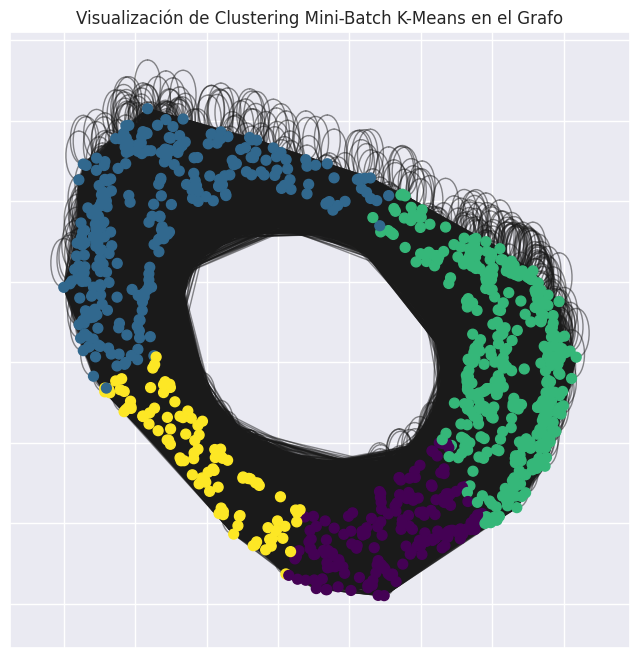

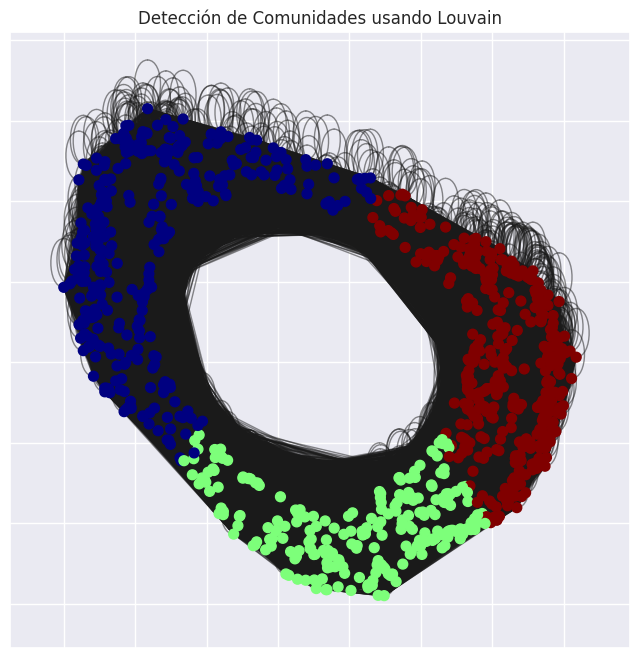

In [ ]:
#@title Aplicación de grafos a la data
import networkx as nx
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import MiniBatchKMeans
import matplotlib.pyplot as plt
import community.community_louvain as community_louvain
import pandas as pd
from scipy.sparse import csr_matrix

# Seleccionar las características numéricas del dataframe y convertir a float32
df_numeric = df_grafos.select_dtypes(include=[np.number]).astype(np.float32)

# Si el dataset es muy grande, realizar un muestreo aleatorio
if len(df_numeric) > 1000:  # Ajustar este número
    df_numeric = df_numeric.sample(n=1000, random_state=42)

# Normalización
scaler = StandardScaler()
data_scaled = scaler.fit_transform(df_numeric)

# PCA
pca = PCA(n_components=2)
data_pca = pca.fit_transform(data_scaled)

# Crear una matriz de similitud de coseno a partir del PCA
similarity_matrix = cosine_similarity(data_pca)

# Convertir a matriz dispersa solo las similitudes significativas
threshold = 0.1  # Umbral
similarity_matrix[similarity_matrix < threshold] = 0
similarity_matrix_sparse = csr_matrix(similarity_matrix)

# Ajustar el modelo Mini-Batch K-Means para clusters
mini_batch_kmeans = MiniBatchKMeans(n_clusters=4, random_state=42, batch_size=100)
labels = mini_batch_kmeans.fit_predict(similarity_matrix_sparse.toarray())

# Crear el grafo usando NetworkX a partir de la matriz dispersa
G = nx.from_scipy_sparse_array(similarity_matrix_sparse)

# Añadir etiquetas de clúster al grafo
for i, node in enumerate(G.nodes()):
    G.nodes[node]['label'] = labels[i]

# Visualización del grafo con clustering Mini-Batch K-Means
pos = nx.spring_layout(G)
plt.figure(figsize=(8, 8))
nx.draw_networkx_nodes(G, pos, node_color=labels, cmap=plt.cm.viridis, node_size=50)
nx.draw_networkx_edges(G, pos, alpha=0.5)
plt.title('Visualización de Clustering Mini-Batch K-Means en el Grafo')
plt.show()

# Aplicar el algoritmo de Louvain para detección de comunidades
partition = community_louvain.best_partition(G)

# Añadir etiquetas de comunidad al grafo
for node, community in partition.items():
    G.nodes[node]['community'] = community

# Visualización de las comunidades
colors = [partition[node] for node in G.nodes()]
plt.figure(figsize=(8, 8))
nx.draw_networkx_nodes(G, pos, node_color=colors, cmap=plt.cm.jet, node_size=50)
nx.draw_networkx_edges(G, pos, alpha=0.5)
plt.title('Detección de Comunidades usando Louvain')
plt.show()
